This used latent space of 1024 and hidden of only 512. But it seems to really struggle because of the smaller hidden space.
    

In [1]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2

/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/matplotlib/__init__.py:1067: UserWarning: Duplicate key in file "/home/ubuntu/.config/matplotlib/matplotlibrc", line #2
  (fname, cnt))
/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/matplotlib/__init__.py:1067: UserWarning: Duplicate key in file "/home/ubuntu/.config/matplotlib/matplotlibrc", line #3
  (fname, cnt))


In [26]:
import torch
from torch.nn import functional as F
from torch.autograd import Variable
from torch import nn, optim
import torch.utils.data

# load as dask array
import dask.array as da
import dask
import h5py

import os
import glob
import numpy as np
from matplotlib import pyplot as plt
from tqdm import tqdm_notebook as tqdm

In [3]:
from world_models_sonic.models.vae import VAE5, loss_function_vae
from world_models_sonic.helpers.summarize import TorchSummarizeDf
from world_models_sonic.helpers.dataset import load_cache_data
from world_models_sonic.models.rnn import MDNRNN2
from world_models_sonic.models.inverse_model import InverseModel
from world_models_sonic.models.world_model import WorldModel
from world_models_sonic.custom_envs.wrappers import discrete_actions
from world_models_sonic import config
len(discrete_actions)

10

# Init

In [24]:
cuda= torch.cuda.is_available()
env_name='sonic256'
num_epochs=200
batch_size = 1

# VAE loss function
lambda_vae_kld = 0.15
C = 0
z_dim = 512 # latent dimensions

# RNN
action_dim = 10
seq_len = 8
image_size=256
chunksize=seq_len*20



# loss function weights
lambda_vae = 1/120
lambda_finv = 1


NAME='RNN_v3b_256im_512z_1512_v6b_VAE5_all'

In [28]:
if not os.path.isdir(f'./outputs/{NAME}'):
    os.makedirs(f'./outputs/{NAME}')
    
data_cache_file = os.path.join(config.data_cache_dir, 'sonic_rnn_256_v31.hdf5')
history_file = './outputs/{NAME}/history.csv'.format(NAME=NAME)
save_file_rnn = './outputs/{NAME}/mdnrnn_state_dict.pkl'.format(NAME=NAME)
save_file_vae = './outputs/{NAME}/vae_state_dict.pkl'.format(NAME=NAME)
save_file_finv = './outputs/{NAME}/finv_state_dict.pkl'.format(NAME=NAME)

In [5]:
data_cache_file

'./data/sonic/vae/sonic_rnn_256_v31.hdf5'

# Load Data

In [6]:
loader_train, loader_test = load_cache_data(
    basedir=config.base_vae_data_dir, 
    env_name=env_name, 
    data_cache_file=data_cache_file, 
    image_size=image_size, 
    chunksize=chunksize, 
    action_dim=action_dim,
    batch_size=batch_size,
    seq_len=seq_len
)
len(loader_train.dataset), len(loader_test.dataset)

Loaded from cache ./data/sonic/vae/sonic_rnn_256_v31.hdf5


(192960, 48240)

In [7]:
batch_size, seq_len

(1, 8)

In [8]:
next(iter(loader_train))[0].shape

torch.Size([8, 256, 256, 3])

# Load VAE

In [9]:
# Load VAE
vae = VAE5(image_size=image_size, z_dim=128, conv_dim=64, code_dim=8, k_dim=512)
if cuda:
    vae.cuda()
    
# Resume
if os.path.isfile(save_file_vae):
    state_dict = torch.load(save_file_vae)
    vae.load_state_dict(state_dict)
    print(f'loaded save_file {save_file_vae}')

loaded checkpoint_file ./outputs/models/VAE5_5bigx256_512z_CVAE_state_dict.pkl
loaded checkpoint_file2 ./outputs/models/RNN_v3b_256im_512z-joint-training_state_dict.pkl
loaded save_file ./outputs/models/RNN_v3b_256im_512z_1512_v6b_VAE5_all-vae_state_dict.pkl


# Load RNN

In [10]:
# Load MDRNN
action_dim, hidden_size, n_mixture, temp = action_dim, 512, 2, 0.0


mdnrnn = MDNRNN2(z_dim, action_dim, hidden_size, n_mixture, temp)

if cuda:
    mdnrnn = mdnrnn.cuda()

In [11]:
# # Resume?
if os.path.isfile(save_file_rnn):
    state_dict = torch.load(save_file_rnn)
    mdnrnn.load_state_dict(state_dict)
    print('loaded {save_file}'.format(save_file_rnn=save_file_rnn))

loaded ./outputs/models/RNN_v3b_256im_512z_1512_v6b_VAE5_all-mdnrnn_state_dict.pkl


# Load inverse model

In [12]:
finv = InverseModel(z_dim, action_dim, hidden_size=256).cuda()

# Resume?
if os.path.isfile(save_file_finv):
    state_dict = torch.load(save_file_finv)
    finv.load_state_dict(state_dict)
    print('loaded {save_file_finv}'.format(save_file_finv=save_file_finv))

loaded ./outputs/models/RNN_v3b_256im_512z_1512_v6b_VAE5_all-finv_state_dict.pkl


# Init

In [13]:
model = WorldModel(vae, mdnrnn, finv)
model

WorldModel(
  (vae): VAE5(
    (logvar): Linear(in_features=8192, out_features=512, bias=True)
    (mu): Linear(in_features=8192, out_features=512, bias=True)
    (z): Linear(in_features=512, out_features=8192, bias=True)
    (encoder): Sequential(
      (0): ConvBlock4(
        (conv): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (act): LeakyReLU(negative_slope=0.01, inplace)
      )
      (1): ConvBlock4(
        (conv): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
        (bn): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (act): LeakyReLU(negative_slope=0.01, inplace)
      )
      (2): ConvBlock4(
        (conv): Conv2d(128, 192, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
        (bn): BatchNorm2d(192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (act): LeakyReLU

# Train helpers

In [14]:
# Plot reconstructions
def plot_results(loader, n=2, epoch=0, figsize=(9,6)):
    with torch.no_grad():
        vae.eval()
        mdnrnn.eval()

        observations, actions, rewars, dones = next(iter(loader))

        X = Variable(observations.transpose(1,3))
        _, channels, height, width = X.size()
        if cuda:
            X=X.cuda()
        Y, mu_vae, logvar = vae.forward(X)
        loss_recon, loss_KLD = loss_function_vae(Y, X, mu_vae, logvar)
        loss_vae = loss_recon + lambda_vae_kld * torch.abs(loss_KLD-C)

        # TODO do we want to sample in test or training mode?
        z_v = vae.sample(mu_vae, logvar)

        z_v = z_v.view(batch_size, seq_len, -1)
        Y = Y.view((batch_size, seq_len, channels, height, width))
        X = X.view((batch_size, seq_len, channels, height, width))
        loss_vae = loss_vae.view(batch_size, seq_len)
        actions = actions.view(batch_size, seq_len)

        # Forward
        actions_v = Variable(actions).float()


        if cuda:
            z_v=z_v.cuda()
            actions_v=actions_v.cuda()
        pi, mu, sigma, hidden_state = mdnrnn.forward(z_v, actions_v)
        z_true_next = z_v[:,1:]
        loss_mdn_rnn = mdnrnn.rnn_loss(z_true_next, pi[:,:-1], mu[:,:-1], sigma[:,:-1])

        mu2 = mu.mean(2).view((batch_size*seq_len, mdnrnn.z_dim))
        X_pred = vae.decode(mu2)
        X_pred = X_pred.view((batch_size, seq_len, channels, height, width))

        # Finv forward
        z_next_pred = mdnrnn.sample(pi, mu, sigma)
        action_pred = finv(z_v[:,1:], z_next_pred[:,:-1]).float()

        actions_v_hot = torch.eye(action_dim)[actions_v.long()].cuda()
        loss_inv = F.binary_cross_entropy_with_logits(action_pred, actions_v_hot[:,1:])
        action_pred_int = action_pred.max(-1)[1]
        print(action_pred_int)

        loss = loss_vae.mean(1) + loss_mdn_rnn.mean(1) + loss_inv.mean()

        for i in np.linspace(0,seq_len-2,n):
            batch = np.random.randint(0,batch_size)
            i=int(i)
            y=Y[batch][i].cpu().data.transpose(0,2).numpy()
            x_orig = X[batch][i].transpose(0,2).data.cpu().numpy()
            x_next = X[batch][i+1].transpose(0,2).data.cpu().numpy()
            x_pred = X_pred[batch][i].transpose(0,2).data.cpu().numpy()
            loss_vae_i = loss_vae[batch][i].cpu().data.item()
            loss_mdnrnn_i = loss_mdn_rnn[batch][i].cpu().data.item()
            loss_inv_i = loss_inv.cpu().data.item()
            loss_i = loss[batch].cpu().data.item()

            print('action_pred', action_pred_int[batch][i].data.cpu().item())
            print('action_true', actions_v[:,1:][batch][i].data.cpu().item())
            print('finv loss {:2.4f}'.format(loss_inv_i))

            plt.figure(figsize=figsize)

            plt.subplot(2, 3, 1)
            plt.axis("off")
            plt.title('original')
            plt.imshow(x_orig)

            plt.subplot(2, 3, 4)
            plt.axis("off")
            plt.imshow(y)
            plt.title('reconstructed \nloss_vae={:2.4f}'.format(loss_vae_i))

            plt.subplot(2, 3, 2)
            plt.axis("off")
            plt.imshow(x_next)
            plt.title('true next')

            plt.subplot(2, 3, 5)
            plt.axis("off")
            plt.imshow(x_pred)
            plt.title('pred next \nloss_mdnrnn={:2.4f}'.format(loss_mdnrnn_i))

            plt.subplot(2, 3, 3)
            plt.axis("off")
            plt.imshow(np.abs(x_orig-x_next))
            plt.title('actual changes')

            plt.subplot(2, 3, 6)
            plt.axis("off")
            plt.imshow(np.abs(y[i]-x_pred))
            plt.title('predicted changes')

            plt.suptitle('epoch {}, seq index {}, batch={}. loss {:2.4f}'.format(
                epoch, 
                i,
                batch,
                loss_i
            ))
            plt.show()
        


In [15]:
import collections

def train(loader, vae, mdnrnn, optimizer, max_batches=None, test=False, cuda=True, joint_training=False):
    vae.eval()
    if test:
        mdnrnn.eval()
    else:
        mdnrnn.train()
    info = collections.defaultdict(list)
    hidden_state = None
    if max_batches is None:
        max_batches = len(loader)
    else:
        max_batches = min(max_batches, len(loader))
    iterator = iter(loader)

    with tqdm(total=max_batches*loader.batch_size, mininterval=0.5, desc='test' if test else 'training') as prog:
        for i in range(max_batches):
            # the loader batch_size is seq_len*batch_size
            # we put it through the VAE as (seq_len*batch_size,...)
            # then reshape to (batch_size,seq_len,...) for the mdnrnn
            observations, actions, rewards, dones = next(iterator)
            X = Variable(observations.transpose(1,3))
            if cuda:
                X=X.cuda()
                
            # VAE forward
            Y, mu_vae, logvar = vae.forward(X)
            
            loss_recon, loss_KLD = loss_function_vae(Y, X, mu_vae, logvar)
            loss_vae = loss_recon + lambda_vae_kld * torch.abs(loss_KLD-C)
            loss_vae = loss_vae.mean() # mean along the batches

            # MDNRNN Forward
            z_v = vae.sample(mu_vae, logvar)
            z_v = z_v.view(batch_size, seq_len, -1)
            actions_v = Variable(actions).float()
            actions_v = actions_v.view(batch_size, seq_len)
            if cuda:
                z_v=z_v.cuda()
                actions_v=actions_v.cuda()
            pi, mu, sigma, hidden_state = mdnrnn.forward(z_v, actions_v)

            # We are evaluating how the output distribution for the next step
            # matches the real next step. So we have to discard the last step in the 
            # sequence which has no next step.
            z_true_next = z_v[:,1:]
            loss_mdn = mdnrnn.rnn_loss(z_true_next, pi[:,:-1], mu[:,:-1], sigma[:,:-1]).mean()
            
            # Finv forward
            z_next_pred = mdnrnn.sample(pi, mu, sigma)
            action_pred = finv(z_v[:,1:], z_next_pred[:,:-1]).float()
            actions_v_hot = torch.eye(action_dim)[actions_v.long()].cuda()
            loss_inv = F.binary_cross_entropy_with_logits(action_pred, actions_v_hot[:,1:])
            loss_inv = loss_inv.mean()
            
            loss = loss_mdn + lambda_finv * loss_inv + lambda_vae * loss_vae

            if not test:
                loss.backward()
                optimizer.step()
                optimizer.zero_grad()

            # Record
            info['loss_inv'].append(loss_inv.cpu().data.numpy())
            info['loss_mdn'].append(loss_mdn.cpu().data.numpy())
            info['loss_vae'].append(loss_vae.cpu().data.numpy())
            info['loss_recon'].append(loss_recon.mean().cpu().data.item())
            info['loss_KLD'].append(loss_KLD.mean().cpu().data.item())
            
            prog.update(loader.batch_size)
            prog.desc='loss={loss:2.4f}, loss_rnn={loss_mdn:2.4f}, loss_inv= {loss_inv2:2.4f}={lambda_finv}* {loss_inv:2.4f}, loss_vae={loss_vae:2.4f}={lambda_vae:2.4f} * ({loss_recon:2.2f} + {lambda_vae_kld}*|{loss_KLD:2.2f} - {C}|)'.format(
                loss=loss.cpu().data.item(),
                loss_mdn=np.mean(info['loss_mdn']), 
                loss_recon=np.mean(info['loss_recon']),
                loss_KLD=np.mean(info['loss_KLD']),
                loss_vae=lambda_vae*(np.mean(info['loss_recon'])+lambda_vae_kld*(np.mean(info['loss_KLD'])-C)),
                loss_inv=np.mean(info['loss_inv']),
                loss_inv2=np.mean(info['loss_inv'])*lambda_finv,
                lambda_vae_kld=lambda_vae_kld,
                lambda_finv=lambda_finv,
                lambda_vae=lambda_vae,
                C=C
            )
            if i%400==0:
                print('[{}/{}]'.format(i, max_batches), prog.desc)

        print(prog.desc)
        prog.close()

    return info

# Train

In [16]:

import torch.optim.lr_scheduler
optimizer = optim.Adam(model.parameters(), lr=1e-5)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', patience=8, verbose=True)
max_batches=10000//loader_train.batch_size
max_batches
torch.cuda.empty_cache()

In [17]:
# Load previous history
import pandas as pd
if os.path.isfile(history_file):
    try:
        histories = pd.read_csv(history_file).to_dict(orient='records')
    except pd.errors.EmptyDataError:
        histories = []
else:
    histories = []

[0/1250] loss=31.6111, loss_rnn=16.7434, loss_inv= 0.7266=1* 0.7266, loss_vae=14.1411=0.0083 * (1696.01 + 0.15*|6.18 - 0|)


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/tqdm/_monitor.py:89: TqdmSynchronisationWarning: Set changed size during iteration (see https://github.com/tqdm/tqdm/issues/481)
  TqdmSynchronisationWarning)


[400/1250] loss=53.7128, loss_rnn=17.1521, loss_inv= 0.7161=1* 0.7161, loss_vae=22.6265=0.0083 * (2714.09 + 0.15*|7.28 - 0|)
[800/1250] loss=49.8672, loss_rnn=17.2214, loss_inv= 0.7160=1* 0.7160, loss_vae=22.6583=0.0083 * (2717.92 + 0.15*|7.18 - 0|)
[1200/1250] loss=38.2470, loss_rnn=17.2560, loss_inv= 0.7161=1* 0.7161, loss_vae=22.9176=0.0083 * (2749.04 + 0.15*|7.18 - 0|)
loss=34.3218, loss_rnn=17.2562, loss_inv= 0.7161=1* 0.7161, loss_vae=22.8286=0.0083 * (2738.36 + 0.15*|7.13 - 0|)



[0/208] loss=31.9109, loss_rnn=17.4999, loss_inv= 0.7266=1* 0.7266, loss_vae=13.6844=0.0083 * (1641.16 + 0.15*|6.45 - 0|)
loss=16.6935, loss_rnn=17.3440, loss_inv= 0.7158=1* 0.7158, loss_vae=25.1813=0.0083 * (3020.78 + 0.15*|6.49 - 0|)

Epoch 0, loss=17.2562, loss_val=17.3440, loss_vae=2739.4272, loss_vae_val=3021.7529,  loss_finv=nan, loss_finv_vae=nan, ,


/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2957: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/numpy/core/_methods.py:80: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.6870


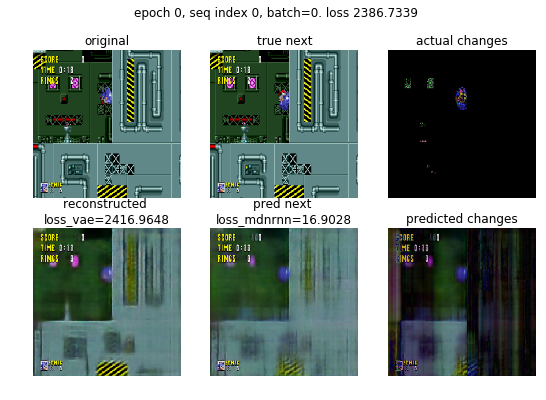

action_pred 2
action_true 2.0
finv loss 0.6870


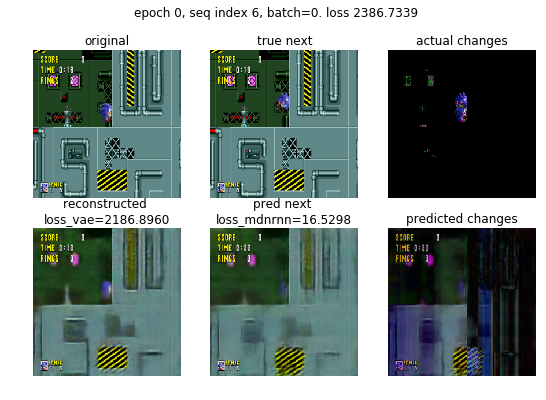

[0/1250] loss=35.8149, loss_rnn=17.2576, loss_inv= 0.7123=1* 0.7123, loss_vae=17.8449=0.0083 * (2140.60 + 0.15*|5.30 - 0|)
[400/1250] loss=43.2193, loss_rnn=17.0966, loss_inv= 0.7179=1* 0.7179, loss_vae=20.8982=0.0083 * (2506.76 + 0.15*|6.89 - 0|)
[800/1250] loss=44.9941, loss_rnn=17.1223, loss_inv= 0.7170=1* 0.7170, loss_vae=21.4007=0.0083 * (2567.04 + 0.15*|6.97 - 0|)
[1200/1250] loss=16.2996, loss_rnn=17.1551, loss_inv= 0.7167=1* 0.7167, loss_vae=20.8570=0.0083 * (2501.79 + 0.15*|7.03 - 0|)
loss=63.9549, loss_rnn=17.1258, loss_inv= 0.7172=1* 0.7172, loss_vae=21.0600=0.0083 * (2526.15 + 0.15*|6.99 - 0|)



[0/208] loss=53.9134, loss_rnn=17.7598, loss_inv= 0.7123=1* 0.7123, loss_vae=35.4413=0.0083 * (4251.45 + 0.15*|10.04 - 0|)
loss=31.2711, loss_rnn=17.4883, loss_inv= 0.7168=1* 0.7168, loss_vae=24.3166=0.0083 * (2916.97 + 0.15*|6.76 - 0|)

Epoch 1, loss=17.1258, loss_val=17.4883, loss_vae=2527.1975, loss_vae_val=2917.9878,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 9.0
finv loss 0.7266


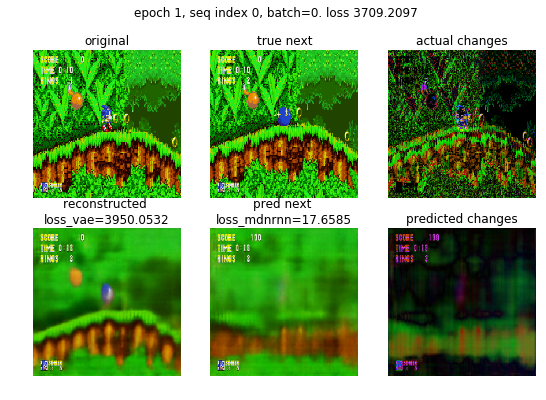

action_pred 2
action_true 3.0
finv loss 0.7266


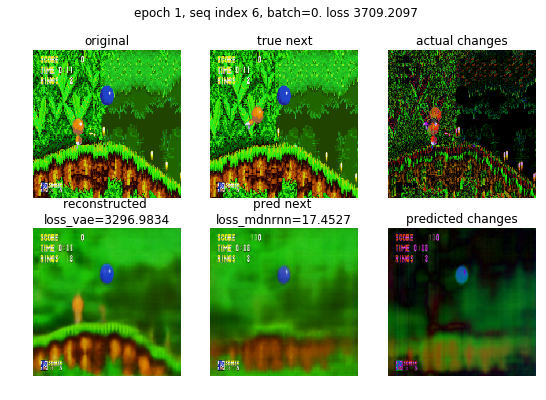

[0/1250] loss=35.6069, loss_rnn=17.2734, loss_inv= 0.7123=1* 0.7123, loss_vae=17.6212=0.0083 * (2113.68 + 0.15*|5.81 - 0|)
[400/1250] loss=45.2562, loss_rnn=17.0949, loss_inv= 0.7176=1* 0.7176, loss_vae=23.0513=0.0083 * (2765.16 + 0.15*|6.62 - 0|)
[800/1250] loss=36.2549, loss_rnn=17.1749, loss_inv= 0.7170=1* 0.7170, loss_vae=22.8317=0.0083 * (2738.79 + 0.15*|6.77 - 0|)
[1200/1250] loss=62.3211, loss_rnn=17.0978, loss_inv= 0.7165=1* 0.7165, loss_vae=21.4014=0.0083 * (2567.16 + 0.15*|6.68 - 0|)
loss=63.0827, loss_rnn=17.1227, loss_inv= 0.7166=1* 0.7166, loss_vae=21.8795=0.0083 * (2624.53 + 0.15*|6.75 - 0|)



[0/208] loss=51.0981, loss_rnn=17.4842, loss_inv= 0.7202=1* 0.7202, loss_vae=32.8938=0.0083 * (3946.36 + 0.15*|5.97 - 0|)
loss=38.2022, loss_rnn=17.1290, loss_inv= 0.7158=1* 0.7158, loss_vae=18.9409=0.0083 * (2271.98 + 0.15*|6.15 - 0|)

Epoch 2, loss=17.1227, loss_val=17.1290, loss_vae=2625.5415, loss_vae_val=2272.9026,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 6.0
finv loss 0.7266


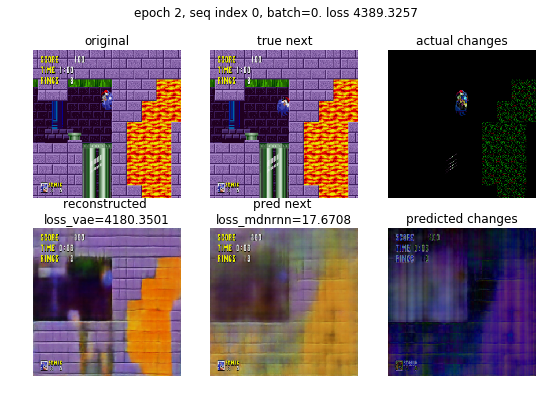

action_pred 2
action_true 8.0
finv loss 0.7266


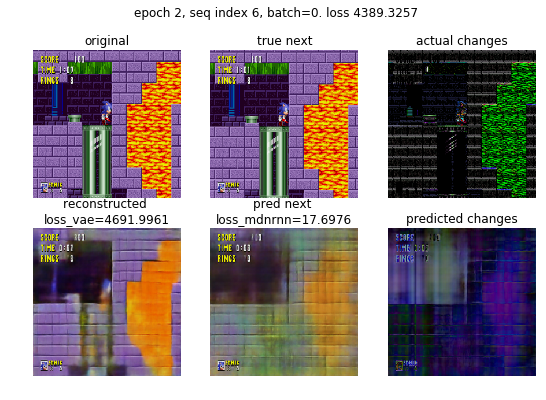

[0/1250] loss=41.3252, loss_rnn=17.8290, loss_inv= 0.7233=1* 0.7233, loss_vae=22.7729=0.0083 * (2731.70 + 0.15*|6.97 - 0|)
[400/1250] loss=61.7567, loss_rnn=17.2476, loss_inv= 0.7158=1* 0.7158, loss_vae=20.7346=0.0083 * (2487.14 + 0.15*|6.69 - 0|)
[800/1250] loss=33.8076, loss_rnn=17.2128, loss_inv= 0.7162=1* 0.7162, loss_vae=20.8696=0.0083 * (2503.34 + 0.15*|6.79 - 0|)
[1200/1250] loss=37.3450, loss_rnn=17.2538, loss_inv= 0.7163=1* 0.7163, loss_vae=22.3324=0.0083 * (2678.85 + 0.15*|6.91 - 0|)
loss=36.0198, loss_rnn=17.2466, loss_inv= 0.7163=1* 0.7163, loss_vae=22.1849=0.0083 * (2661.16 + 0.15*|6.86 - 0|)



[0/208] loss=49.3655, loss_rnn=17.5877, loss_inv= 0.6980=1* 0.6980, loss_vae=31.0797=0.0083 * (3728.05 + 0.15*|10.06 - 0|)
loss=27.7494, loss_rnn=17.2433, loss_inv= 0.7159=1* 0.7159, loss_vae=20.4089=0.0083 * (2448.09 + 0.15*|6.52 - 0|)

Epoch 3, loss=17.2466, loss_val=17.2433, loss_vae=2662.1858, loss_vae_val=2449.0713,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7110


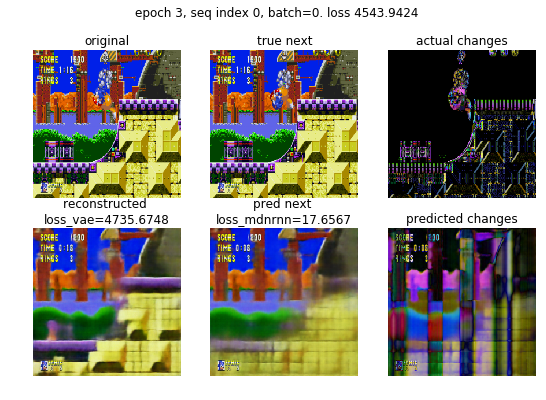

action_pred 2
action_true 2.0
finv loss 0.7110


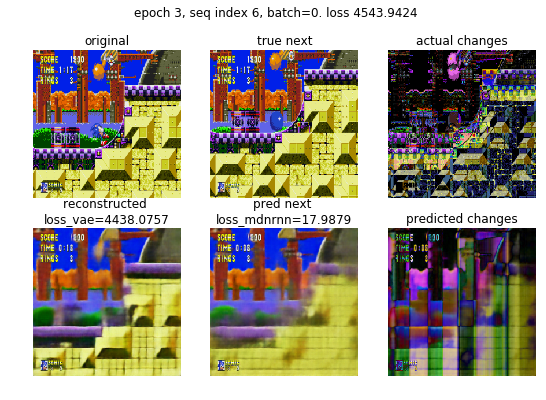

[0/1250] loss=28.5337, loss_rnn=17.7078, loss_inv= 0.7022=1* 0.7022, loss_vae=10.1238=0.0083 * (1214.00 + 0.15*|5.70 - 0|)
[400/1250] loss=64.5229, loss_rnn=17.3411, loss_inv= 0.7158=1* 0.7158, loss_vae=27.7583=0.0083 * (3330.03 + 0.15*|6.46 - 0|)
[800/1250] loss=34.3266, loss_rnn=17.3421, loss_inv= 0.7157=1* 0.7157, loss_vae=26.3604=0.0083 * (3162.26 + 0.15*|6.60 - 0|)
[1200/1250] loss=40.6540, loss_rnn=17.3243, loss_inv= 0.7158=1* 0.7158, loss_vae=25.4154=0.0083 * (3048.85 + 0.15*|6.70 - 0|)
loss=82.1870, loss_rnn=17.3237, loss_inv= 0.7158=1* 0.7158, loss_vae=25.4170=0.0083 * (3049.03 + 0.15*|6.72 - 0|)



[0/208] loss=17.4855, loss_rnn=15.6668, loss_inv= 0.7123=1* 0.7123, loss_vae=1.1064=0.0083 * (132.00 + 0.15*|5.07 - 0|)
loss=37.0411, loss_rnn=17.1734, loss_inv= 0.7164=1* 0.7164, loss_vae=18.8357=0.0083 * (2259.38 + 0.15*|6.06 - 0|)

Epoch 4, loss=17.3237, loss_val=17.1734, loss_vae=3050.0427, loss_vae_val=2260.2849,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7123


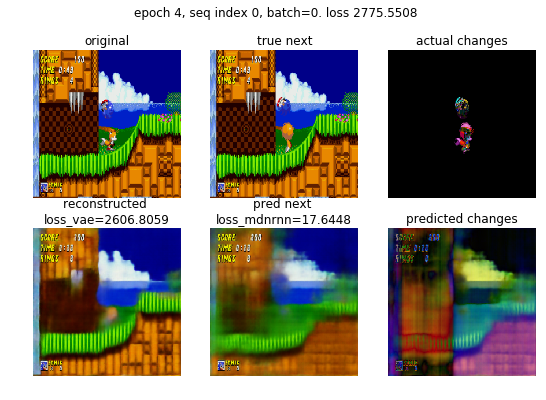

action_pred 2
action_true 2.0
finv loss 0.7123


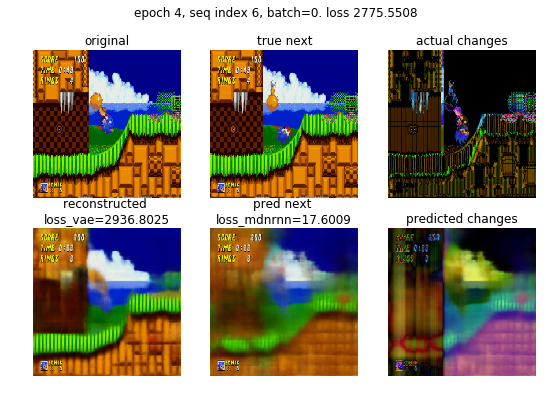

[0/1250] loss=38.7558, loss_rnn=17.3312, loss_inv= 0.7266=1* 0.7266, loss_vae=20.6981=0.0083 * (2482.84 + 0.15*|6.21 - 0|)
[400/1250] loss=16.7188, loss_rnn=17.0974, loss_inv= 0.7156=1* 0.7156, loss_vae=20.5956=0.0083 * (2470.59 + 0.15*|5.91 - 0|)
[800/1250] loss=77.8567, loss_rnn=17.0714, loss_inv= 0.7166=1* 0.7166, loss_vae=21.7862=0.0083 * (2613.41 + 0.15*|6.25 - 0|)
[1200/1250] loss=32.5557, loss_rnn=17.1288, loss_inv= 0.7163=1* 0.7163, loss_vae=21.8478=0.0083 * (2620.80 + 0.15*|6.28 - 0|)
loss=47.6483, loss_rnn=17.1190, loss_inv= 0.7163=1* 0.7163, loss_vae=21.4963=0.0083 * (2578.62 + 0.15*|6.25 - 0|)



[0/208] loss=51.0271, loss_rnn=17.2220, loss_inv= 0.7124=1* 0.7124, loss_vae=33.0927=0.0083 * (3970.01 + 0.15*|7.44 - 0|)
loss=51.4706, loss_rnn=17.5067, loss_inv= 0.7170=1* 0.7170, loss_vae=28.9146=0.0083 * (3468.74 + 0.15*|6.69 - 0|)

Epoch 5, loss=17.1190, loss_val=17.5067, loss_vae=2579.5540, loss_vae_val=3469.7463,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 5.0
finv loss 0.7263


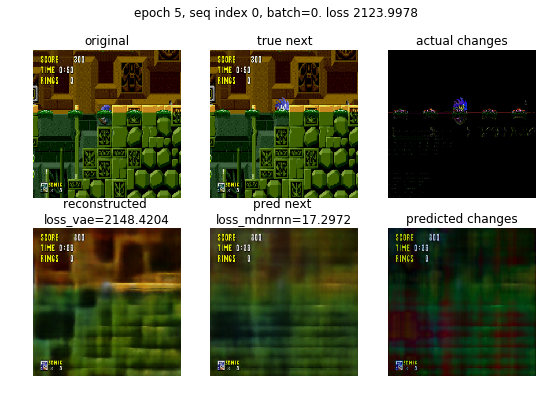

action_pred 2
action_true 8.0
finv loss 0.7263


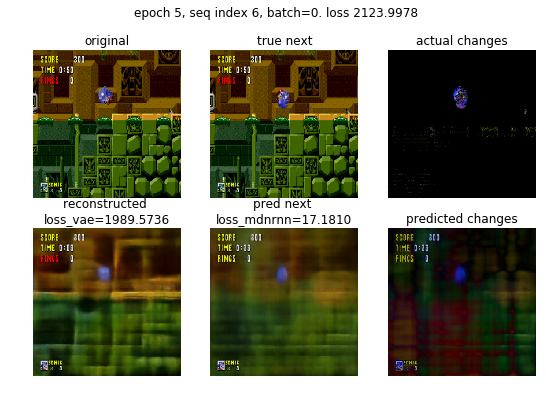

[0/1250] loss=40.3446, loss_rnn=17.5864, loss_inv= 0.6996=1* 0.6996, loss_vae=22.0586=0.0083 * (2645.97 + 0.15*|7.10 - 0|)
[400/1250] loss=34.3506, loss_rnn=17.2726, loss_inv= 0.7157=1* 0.7157, loss_vae=24.3012=0.0083 * (2915.13 + 0.15*|6.71 - 0|)
[800/1250] loss=37.6347, loss_rnn=17.1880, loss_inv= 0.7159=1* 0.7159, loss_vae=21.9098=0.0083 * (2628.18 + 0.15*|6.67 - 0|)
[1200/1250] loss=31.8829, loss_rnn=17.1597, loss_inv= 0.7164=1* 0.7164, loss_vae=22.1402=0.0083 * (2655.82 + 0.15*|6.69 - 0|)
loss=36.2915, loss_rnn=17.1369, loss_inv= 0.7164=1* 0.7164, loss_vae=21.7756=0.0083 * (2612.07 + 0.15*|6.70 - 0|)



[0/208] loss=35.1981, loss_rnn=16.3075, loss_inv= 0.7123=1* 0.7123, loss_vae=18.1783=0.0083 * (2180.68 + 0.15*|4.74 - 0|)
loss=48.6422, loss_rnn=17.0651, loss_inv= 0.7158=1* 0.7158, loss_vae=18.1201=0.0083 * (2173.54 + 0.15*|5.76 - 0|)

Epoch 6, loss=17.1369, loss_val=17.0651, loss_vae=2613.0708, loss_vae_val=2174.4097,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7127


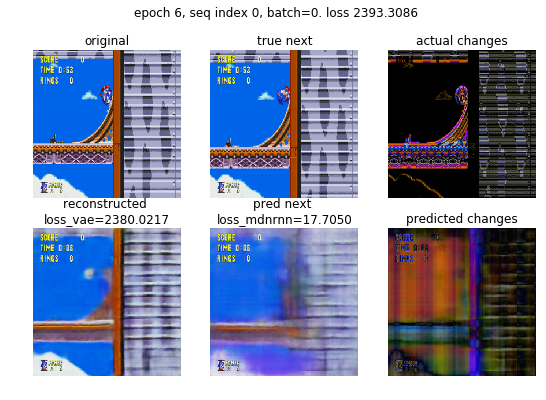

action_pred 2
action_true 2.0
finv loss 0.7127


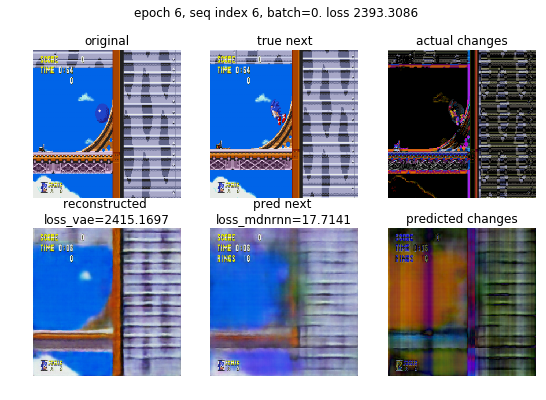

[0/1250] loss=18.0899, loss_rnn=16.9551, loss_inv= 0.7265=1* 0.7265, loss_vae=0.4083=0.0083 * (48.04 + 0.15*|6.33 - 0|)
[400/1250] loss=35.8618, loss_rnn=16.9757, loss_inv= 0.7182=1* 0.7182, loss_vae=21.1622=0.0083 * (2538.54 + 0.15*|6.19 - 0|)
[800/1250] loss=40.8702, loss_rnn=17.0585, loss_inv= 0.7170=1* 0.7170, loss_vae=22.3900=0.0083 * (2685.85 + 0.15*|6.29 - 0|)
[1200/1250] loss=24.4325, loss_rnn=17.0642, loss_inv= 0.7166=1* 0.7166, loss_vae=21.5253=0.0083 * (2582.09 + 0.15*|6.28 - 0|)
loss=44.7516, loss_rnn=17.0672, loss_inv= 0.7166=1* 0.7166, loss_vae=21.5531=0.0083 * (2585.42 + 0.15*|6.34 - 0|)



[0/208] loss=19.1680, loss_rnn=16.0078, loss_inv= 0.7266=1* 0.7266, loss_vae=2.4336=0.0083 * (291.18 + 0.15*|5.68 - 0|)
loss=44.0003, loss_rnn=17.1619, loss_inv= 0.7150=1* 0.7150, loss_vae=20.3188=0.0083 * (2437.36 + 0.15*|5.95 - 0|)

Epoch 7, loss=17.0672, loss_val=17.1619, loss_vae=2586.3689, loss_vae_val=2438.2539,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 7.0
finv loss 0.7265


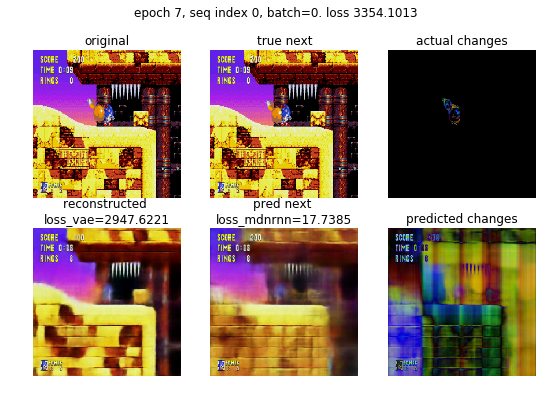

action_pred 2
action_true 8.0
finv loss 0.7265


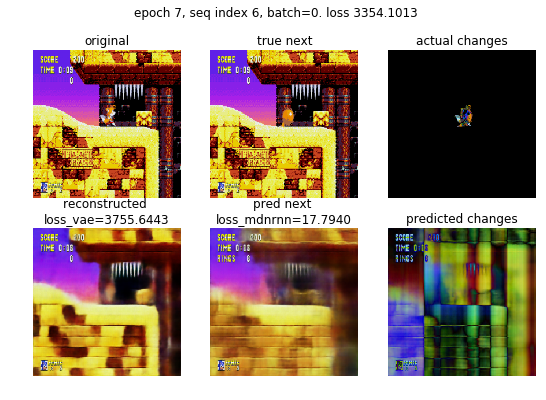

[0/1250] loss=36.7964, loss_rnn=17.0015, loss_inv= 0.7123=1* 0.7123, loss_vae=19.0826=0.0083 * (2288.77 + 0.15*|7.62 - 0|)
[400/1250] loss=16.5755, loss_rnn=17.0335, loss_inv= 0.7155=1* 0.7155, loss_vae=24.2720=0.0083 * (2911.64 + 0.15*|6.64 - 0|)
[800/1250] loss=50.8878, loss_rnn=16.9994, loss_inv= 0.7154=1* 0.7154, loss_vae=21.5968=0.0083 * (2590.65 + 0.15*|6.43 - 0|)
[1200/1250] loss=59.0594, loss_rnn=17.0809, loss_inv= 0.7154=1* 0.7154, loss_vae=22.7898=0.0083 * (2733.82 + 0.15*|6.36 - 0|)
loss=39.5582, loss_rnn=17.0940, loss_inv= 0.7155=1* 0.7155, loss_vae=22.9110=0.0083 * (2748.36 + 0.15*|6.36 - 0|)



[0/208] loss=37.0045, loss_rnn=16.7818, loss_inv= 0.7123=1* 0.7123, loss_vae=19.5104=0.0083 * (2340.46 + 0.15*|5.28 - 0|)
loss=33.1918, loss_rnn=17.1470, loss_inv= 0.7153=1* 0.7153, loss_vae=19.1225=0.0083 * (2293.77 + 0.15*|6.18 - 0|)

Epoch 8, loss=17.0940, loss_val=17.1470, loss_vae=2749.3179, loss_vae_val=2294.7017,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 8.0
finv loss 0.7123


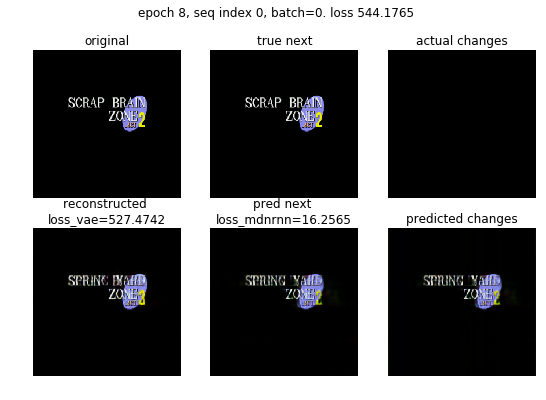

action_pred 2
action_true 4.0
finv loss 0.7123


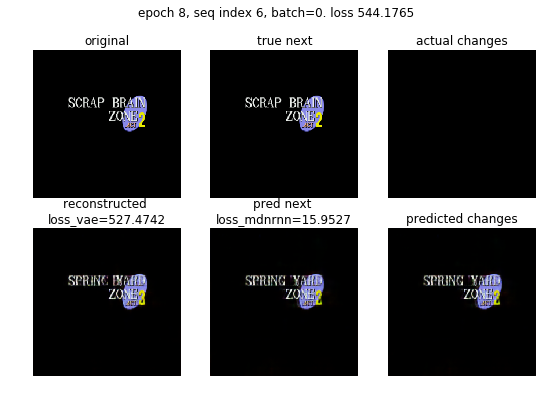

[0/1250] loss=28.9957, loss_rnn=16.9909, loss_inv= 0.7266=1* 0.7266, loss_vae=11.2783=0.0083 * (1352.27 + 0.15*|7.50 - 0|)
[400/1250] loss=59.7214, loss_rnn=17.2088, loss_inv= 0.7158=1* 0.7158, loss_vae=21.4988=0.0083 * (2578.82 + 0.15*|6.91 - 0|)
[800/1250] loss=36.9868, loss_rnn=17.1856, loss_inv= 0.7159=1* 0.7159, loss_vae=21.9940=0.0083 * (2638.28 + 0.15*|6.66 - 0|)
[1200/1250] loss=55.5666, loss_rnn=17.2280, loss_inv= 0.7158=1* 0.7158, loss_vae=22.6262=0.0083 * (2714.15 + 0.15*|6.65 - 0|)
loss=65.2420, loss_rnn=17.2271, loss_inv= 0.7158=1* 0.7158, loss_vae=22.9407=0.0083 * (2751.89 + 0.15*|6.62 - 0|)



[0/208] loss=35.2386, loss_rnn=16.8909, loss_inv= 0.7266=1* 0.7266, loss_vae=17.6212=0.0083 * (2113.84 + 0.15*|4.68 - 0|)
loss=38.5801, loss_rnn=17.4127, loss_inv= 0.7163=1* 0.7163, loss_vae=30.4903=0.0083 * (3657.76 + 0.15*|7.22 - 0|)

Epoch 9, loss=17.2271, loss_val=17.4127, loss_vae=2752.8784, loss_vae_val=3658.8389,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7122


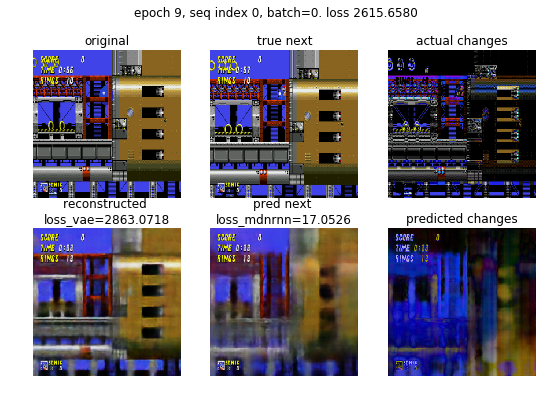

action_pred 2
action_true 2.0
finv loss 0.7122


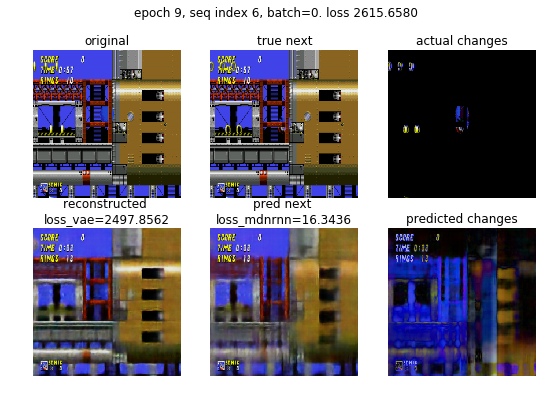

[0/1250] loss=39.5518, loss_rnn=17.4967, loss_inv= 0.7115=1* 0.7115, loss_vae=21.3436=0.0083 * (2560.11 + 0.15*|7.48 - 0|)
[400/1250] loss=34.4031, loss_rnn=17.1285, loss_inv= 0.7165=1* 0.7165, loss_vae=25.5018=0.0083 * (3059.26 + 0.15*|6.42 - 0|)
[800/1250] loss=52.0046, loss_rnn=17.1439, loss_inv= 0.7158=1* 0.7158, loss_vae=22.5590=0.0083 * (2706.12 + 0.15*|6.39 - 0|)
[1200/1250] loss=61.7718, loss_rnn=17.1417, loss_inv= 0.7158=1* 0.7158, loss_vae=22.3514=0.0083 * (2681.21 + 0.15*|6.36 - 0|)
loss=74.5214, loss_rnn=17.1611, loss_inv= 0.7159=1* 0.7159, loss_vae=22.9487=0.0083 * (2752.88 + 0.15*|6.40 - 0|)



[0/208] loss=16.2849, loss_rnn=15.2563, loss_inv= 0.7005=1* 0.7005, loss_vae=0.3281=0.0083 * (38.80 + 0.15*|3.82 - 0|)
loss=36.2344, loss_rnn=17.1768, loss_inv= 0.7167=1* 0.7167, loss_vae=19.5687=0.0083 * (2347.27 + 0.15*|6.46 - 0|)

Epoch 10, loss=17.1611, loss_val=17.1768, loss_vae=2753.8445, loss_vae_val=2348.2405,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 9.0
finv loss 0.7261


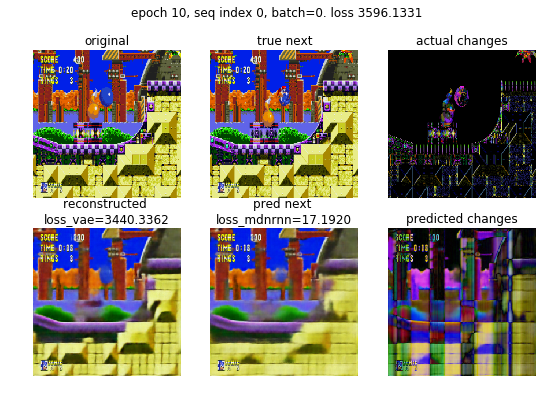

action_pred 2
action_true 9.0
finv loss 0.7261


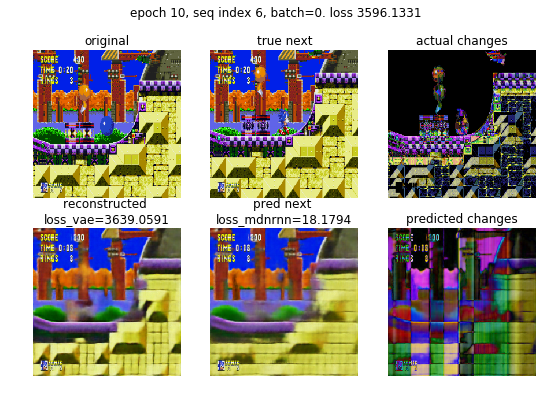

[0/1250] loss=52.2962, loss_rnn=17.4981, loss_inv= 0.7266=1* 0.7266, loss_vae=34.0715=0.0083 * (4087.50 + 0.15*|7.20 - 0|)
[400/1250] loss=30.7446, loss_rnn=17.1240, loss_inv= 0.7156=1* 0.7156, loss_vae=23.2770=0.0083 * (2792.26 + 0.15*|6.50 - 0|)
[800/1250] loss=63.4750, loss_rnn=17.1068, loss_inv= 0.7157=1* 0.7157, loss_vae=22.1503=0.0083 * (2657.11 + 0.15*|6.18 - 0|)
[1200/1250] loss=19.8769, loss_rnn=17.1008, loss_inv= 0.7158=1* 0.7158, loss_vae=22.9461=0.0083 * (2752.60 + 0.15*|6.25 - 0|)
loss=71.0566, loss_rnn=17.0802, loss_inv= 0.7158=1* 0.7158, loss_vae=22.9266=0.0083 * (2750.25 + 0.15*|6.22 - 0|)



[0/208] loss=38.2024, loss_rnn=17.2819, loss_inv= 0.6999=1* 0.6999, loss_vae=20.2205=0.0083 * (2425.76 + 0.15*|4.72 - 0|)
loss=48.4221, loss_rnn=17.3458, loss_inv= 0.7167=1* 0.7167, loss_vae=24.5703=0.0083 * (2947.49 + 0.15*|6.27 - 0|)

Epoch 11, loss=17.0802, loss_val=17.3458, loss_vae=2751.1875, loss_vae_val=2948.4299,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7172


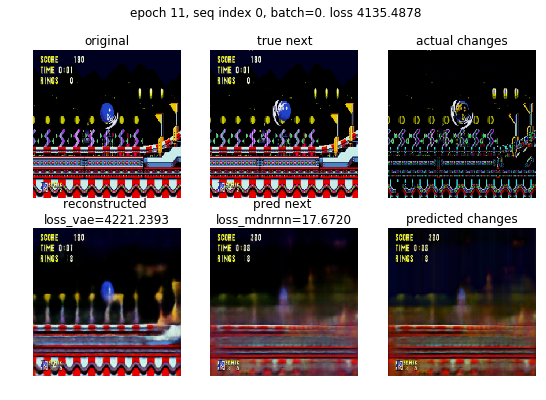

action_pred 2
action_true 2.0
finv loss 0.7172


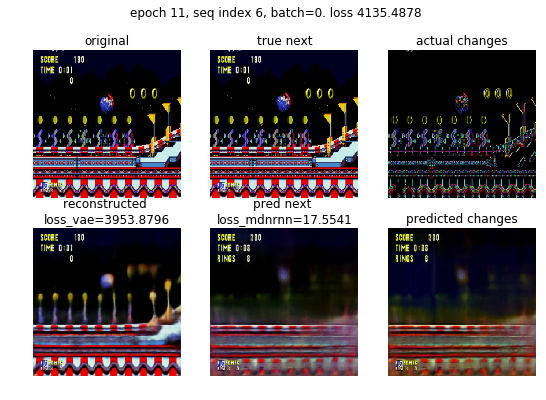

[0/1250] loss=31.3616, loss_rnn=17.1986, loss_inv= 0.6980=1* 0.6980, loss_vae=13.4649=0.0083 * (1614.65 + 0.15*|7.65 - 0|)
[400/1250] loss=36.1732, loss_rnn=17.1243, loss_inv= 0.7164=1* 0.7164, loss_vae=23.5298=0.0083 * (2822.72 + 0.15*|5.68 - 0|)
[800/1250] loss=36.8042, loss_rnn=17.1461, loss_inv= 0.7159=1* 0.7159, loss_vae=22.7430=0.0083 * (2728.29 + 0.15*|5.80 - 0|)
[1200/1250] loss=33.9532, loss_rnn=17.1274, loss_inv= 0.7159=1* 0.7159, loss_vae=23.1660=0.0083 * (2779.03 + 0.15*|5.98 - 0|)
loss=26.1727, loss_rnn=17.1298, loss_inv= 0.7159=1* 0.7159, loss_vae=23.1686=0.0083 * (2779.33 + 0.15*|6.00 - 0|)



[0/208] loss=18.1358, loss_rnn=17.1417, loss_inv= 0.7116=1* 0.7116, loss_vae=0.2824=0.0083 * (33.18 + 0.15*|4.74 - 0|)
loss=37.2114, loss_rnn=17.2024, loss_inv= 0.7163=1* 0.7163, loss_vae=22.3097=0.0083 * (2676.32 + 0.15*|5.66 - 0|)

Epoch 12, loss=17.1298, loss_val=17.2024, loss_vae=2780.2339, loss_vae_val=2677.1694,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 8.0
finv loss 0.7273


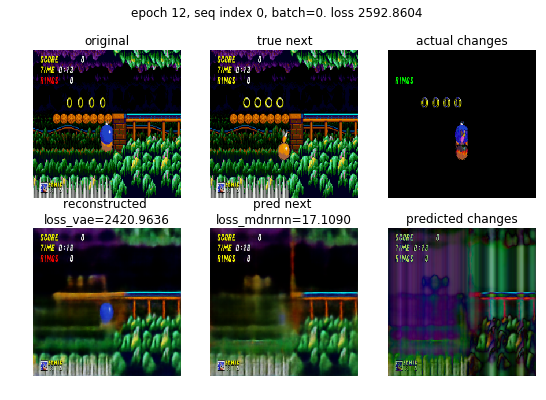

action_pred 2
action_true 8.0
finv loss 0.7273


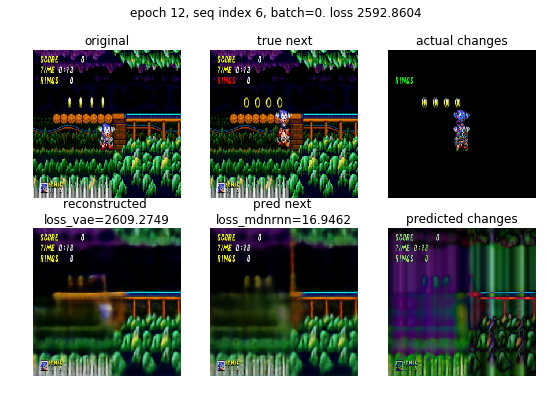

[0/1250] loss=38.9714, loss_rnn=17.5883, loss_inv= 0.7266=1* 0.7266, loss_vae=20.6565=0.0083 * (2477.67 + 0.15*|7.39 - 0|)
[400/1250] loss=38.1851, loss_rnn=17.0501, loss_inv= 0.7150=1* 0.7150, loss_vae=22.4791=0.0083 * (2696.56 + 0.15*|6.19 - 0|)
[800/1250] loss=38.3598, loss_rnn=17.0136, loss_inv= 0.7153=1* 0.7153, loss_vae=20.0518=0.0083 * (2405.30 + 0.15*|6.10 - 0|)
[1200/1250] loss=40.5530, loss_rnn=17.0354, loss_inv= 0.7153=1* 0.7153, loss_vae=21.5119=0.0083 * (2580.53 + 0.15*|5.98 - 0|)
loss=54.4465, loss_rnn=17.0335, loss_inv= 0.7153=1* 0.7153, loss_vae=21.4466=0.0083 * (2572.70 + 0.15*|5.97 - 0|)



[0/208] loss=58.3453, loss_rnn=17.5225, loss_inv= 0.7123=1* 0.7123, loss_vae=40.1106=0.0083 * (4812.27 + 0.15*|6.65 - 0|)
loss=51.5875, loss_rnn=17.2750, loss_inv= 0.7167=1* 0.7167, loss_vae=22.8875=0.0083 * (2745.66 + 0.15*|5.64 - 0|)

Epoch 13, loss=17.0335, loss_val=17.2750, loss_vae=2573.5903, loss_vae_val=2746.5015,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 1.0
finv loss 0.7266


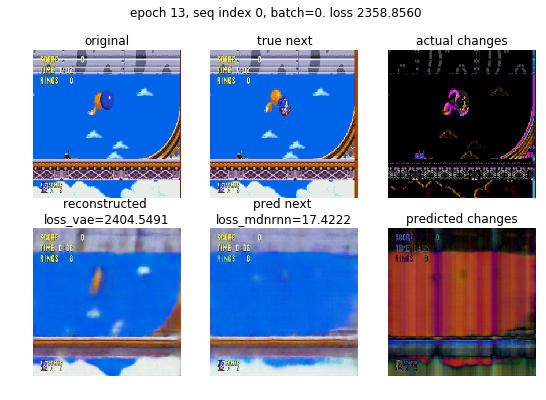

action_pred 2
action_true 6.0
finv loss 0.7266


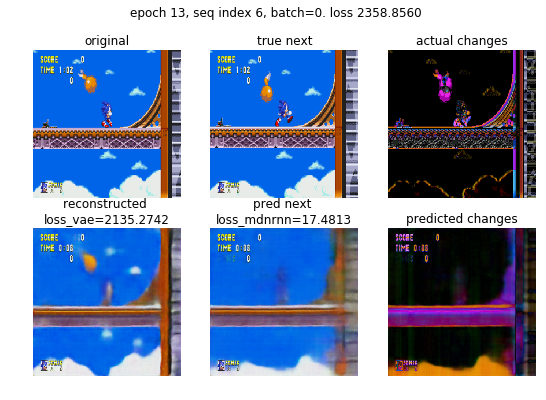

[0/1250] loss=71.8784, loss_rnn=17.6142, loss_inv= 0.6980=1* 0.6980, loss_vae=53.5662=0.0083 * (6426.85 + 0.15*|7.31 - 0|)
[400/1250] loss=17.7132, loss_rnn=17.0524, loss_inv= 0.7178=1* 0.7178, loss_vae=22.7862=0.0083 * (2733.36 + 0.15*|6.56 - 0|)
[800/1250] loss=52.2165, loss_rnn=17.0061, loss_inv= 0.7175=1* 0.7175, loss_vae=21.4099=0.0083 * (2568.27 + 0.15*|6.13 - 0|)
[1200/1250] loss=46.6458, loss_rnn=17.0343, loss_inv= 0.7171=1* 0.7171, loss_vae=21.9708=0.0083 * (2635.59 + 0.15*|6.06 - 0|)
loss=29.4218, loss_rnn=17.0178, loss_inv= 0.7171=1* 0.7171, loss_vae=21.9202=0.0083 * (2629.52 + 0.15*|6.03 - 0|)



[0/208] loss=40.5136, loss_rnn=17.2208, loss_inv= 0.7266=1* 0.7266, loss_vae=22.5662=0.0083 * (2707.30 + 0.15*|4.29 - 0|)
loss=45.4666, loss_rnn=17.1377, loss_inv= 0.7154=1* 0.7154, loss_vae=21.1383=0.0083 * (2535.76 + 0.15*|5.52 - 0|)

Epoch 14, loss=17.0178, loss_val=17.1377, loss_vae=2630.4209, loss_vae_val=2536.5916,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 1.0
finv loss 0.7263


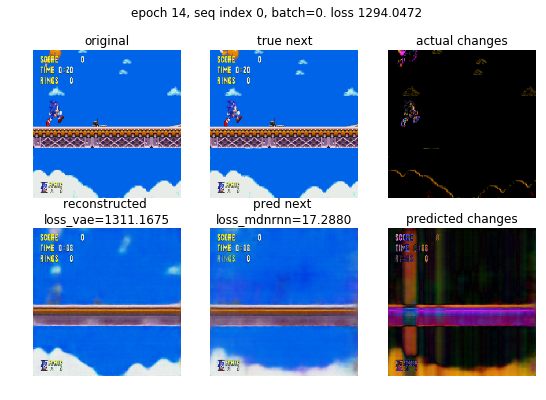

action_pred 2
action_true 8.0
finv loss 0.7263


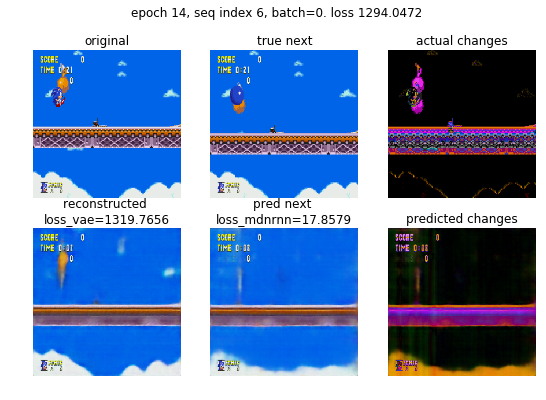

[0/1250] loss=37.2343, loss_rnn=16.7202, loss_inv= 0.7267=1* 0.7267, loss_vae=19.7874=0.0083 * (2373.76 + 0.15*|4.82 - 0|)
[400/1250] loss=40.6600, loss_rnn=16.9663, loss_inv= 0.7162=1* 0.7162, loss_vae=21.7076=0.0083 * (2604.07 + 0.15*|5.56 - 0|)
[800/1250] loss=38.7345, loss_rnn=17.0695, loss_inv= 0.7158=1* 0.7158, loss_vae=22.0820=0.0083 * (2648.96 + 0.15*|5.86 - 0|)
[1200/1250] loss=42.5631, loss_rnn=17.0620, loss_inv= 0.7159=1* 0.7159, loss_vae=21.9895=0.0083 * (2637.86 + 0.15*|5.87 - 0|)
loss=44.3551, loss_rnn=17.0688, loss_inv= 0.7160=1* 0.7160, loss_vae=22.4513=0.0083 * (2693.28 + 0.15*|5.84 - 0|)



[0/208] loss=41.3067, loss_rnn=17.0990, loss_inv= 0.7266=1* 0.7266, loss_vae=23.4811=0.0083 * (2817.03 + 0.15*|4.72 - 0|)
loss=43.4874, loss_rnn=17.2715, loss_inv= 0.7157=1* 0.7157, loss_vae=21.8590=0.0083 * (2622.18 + 0.15*|5.96 - 0|)

Epoch    19: reducing learning rate of group 0 to 1.0000e-06.
Epoch 15, loss=17.0688, loss_val=17.2715, loss_vae=2694.1541, loss_vae_val=2623.0745,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 8.0
finv loss 0.7123


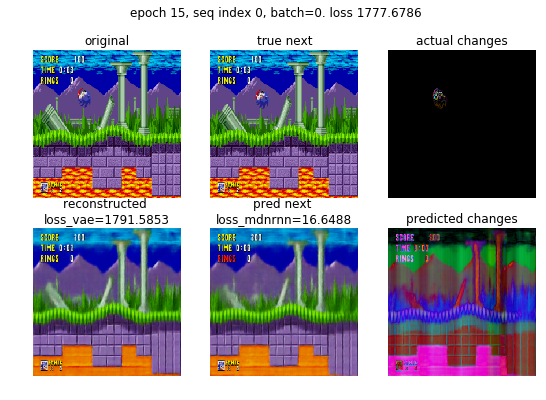

action_pred 2
action_true 9.0
finv loss 0.7123


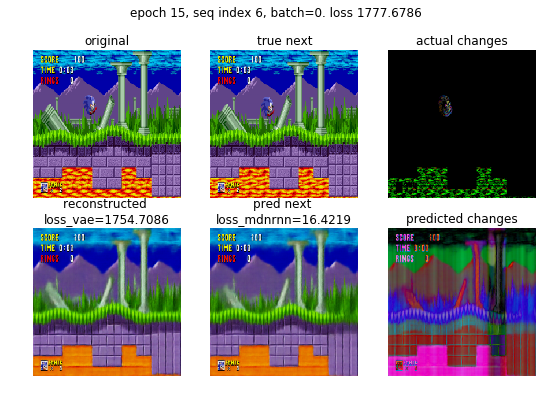

[0/1250] loss=47.0503, loss_rnn=17.3144, loss_inv= 0.6837=1* 0.6837, loss_vae=29.0522=0.0083 * (3485.32 + 0.15*|6.25 - 0|)
[400/1250] loss=38.0782, loss_rnn=17.1058, loss_inv= 0.7156=1* 0.7156, loss_vae=20.8057=0.0083 * (2495.82 + 0.15*|5.73 - 0|)
[800/1250] loss=24.9279, loss_rnn=17.1735, loss_inv= 0.7156=1* 0.7156, loss_vae=25.4019=0.0083 * (3047.33 + 0.15*|5.97 - 0|)
[1200/1250] loss=47.5230, loss_rnn=17.0823, loss_inv= 0.7156=1* 0.7156, loss_vae=23.1439=0.0083 * (2776.38 + 0.15*|5.92 - 0|)
loss=31.6282, loss_rnn=17.0733, loss_inv= 0.7155=1* 0.7155, loss_vae=22.9391=0.0083 * (2751.81 + 0.15*|5.87 - 0|)



[0/208] loss=57.9058, loss_rnn=17.5178, loss_inv= 0.7123=1* 0.7123, loss_vae=39.6757=0.0083 * (4760.17 + 0.15*|6.05 - 0|)
loss=33.5105, loss_rnn=17.4046, loss_inv= 0.7152=1* 0.7152, loss_vae=26.5640=0.0083 * (3186.81 + 0.15*|5.84 - 0|)

Epoch 16, loss=17.0733, loss_val=17.4046, loss_vae=2752.6919, loss_vae_val=3187.6836,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7123


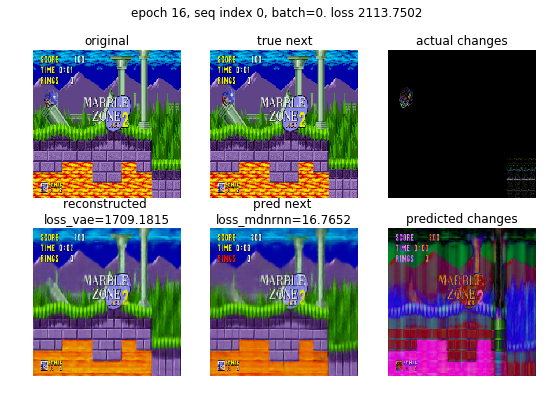

action_pred 2
action_true 2.0
finv loss 0.7123


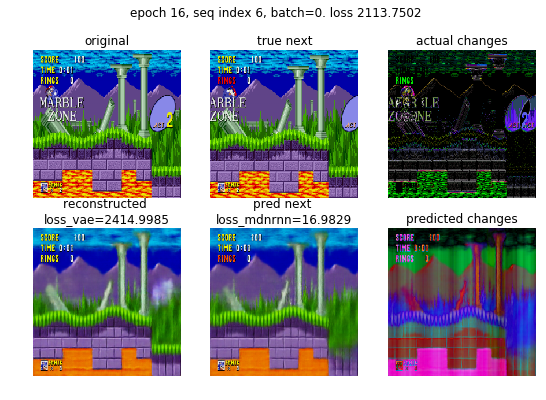

[0/1250] loss=38.7581, loss_rnn=17.2027, loss_inv= 0.6980=1* 0.6980, loss_vae=20.8575=0.0083 * (2502.25 + 0.15*|4.31 - 0|)
[400/1250] loss=55.9741, loss_rnn=16.8955, loss_inv= 0.7156=1* 0.7156, loss_vae=21.1492=0.0083 * (2537.02 + 0.15*|5.86 - 0|)
[800/1250] loss=30.7121, loss_rnn=17.0911, loss_inv= 0.7157=1* 0.7157, loss_vae=22.6497=0.0083 * (2717.06 + 0.15*|6.06 - 0|)
[1200/1250] loss=34.7239, loss_rnn=17.0067, loss_inv= 0.7162=1* 0.7162, loss_vae=22.2325=0.0083 * (2667.00 + 0.15*|6.02 - 0|)
loss=24.1282, loss_rnn=17.0119, loss_inv= 0.7162=1* 0.7162, loss_vae=22.2113=0.0083 * (2664.46 + 0.15*|5.97 - 0|)



[0/208] loss=36.4115, loss_rnn=17.3745, loss_inv= 0.7123=1* 0.7123, loss_vae=18.3247=0.0083 * (2198.14 + 0.15*|5.43 - 0|)
loss=38.0896, loss_rnn=17.2262, loss_inv= 0.7154=1* 0.7154, loss_vae=22.4258=0.0083 * (2690.28 + 0.15*|5.43 - 0|)

Epoch 17, loss=17.0119, loss_val=17.2262, loss_vae=2665.3547, loss_vae_val=2691.0947,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.6980


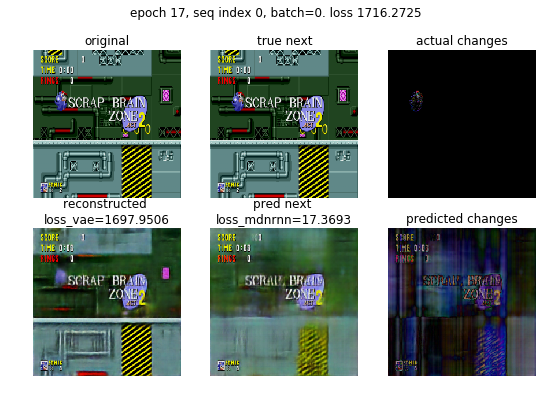

action_pred 2
action_true 2.0
finv loss 0.6980


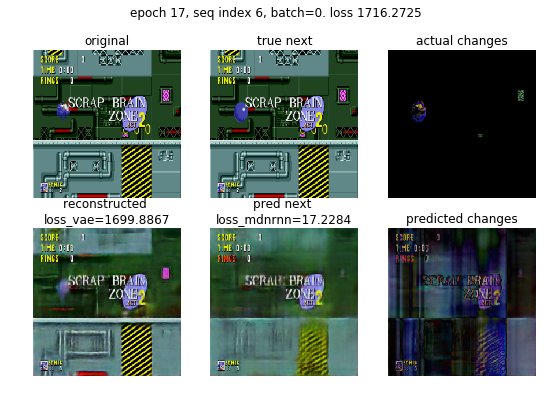

[0/1250] loss=45.9385, loss_rnn=17.6558, loss_inv= 0.7266=1* 0.7266, loss_vae=27.5561=0.0083 * (3305.91 + 0.15*|5.43 - 0|)
[400/1250] loss=56.6582, loss_rnn=16.8925, loss_inv= 0.7182=1* 0.7182, loss_vae=16.4107=0.0083 * (1968.41 + 0.15*|5.80 - 0|)
[800/1250] loss=35.3565, loss_rnn=16.9759, loss_inv= 0.7171=1* 0.7171, loss_vae=19.9299=0.0083 * (2390.73 + 0.15*|5.79 - 0|)
[1200/1250] loss=34.6320, loss_rnn=16.9396, loss_inv= 0.7172=1* 0.7172, loss_vae=20.3649=0.0083 * (2442.94 + 0.15*|5.64 - 0|)
loss=34.7586, loss_rnn=16.9394, loss_inv= 0.7172=1* 0.7172, loss_vae=20.2381=0.0083 * (2427.72 + 0.15*|5.64 - 0|)



[0/208] loss=45.8995, loss_rnn=17.4593, loss_inv= 0.7123=1* 0.7123, loss_vae=27.7279=0.0083 * (3326.29 + 0.15*|7.03 - 0|)
loss=42.5980, loss_rnn=17.0276, loss_inv= 0.7161=1* 0.7161, loss_vae=22.2577=0.0083 * (2670.04 + 0.15*|5.93 - 0|)

Epoch 18, loss=16.9394, loss_val=17.0276, loss_vae=2428.5679, loss_vae_val=2670.9272,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 1.0
finv loss 0.7123


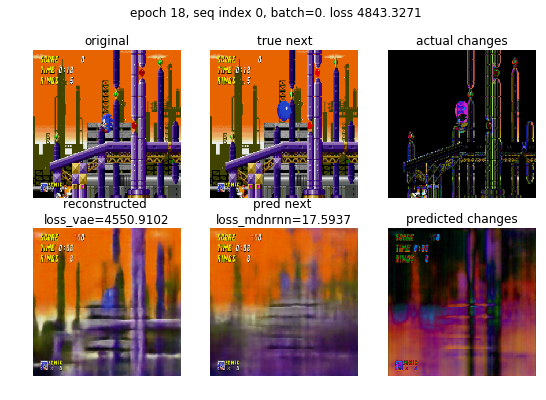

action_pred 2
action_true 8.0
finv loss 0.7123


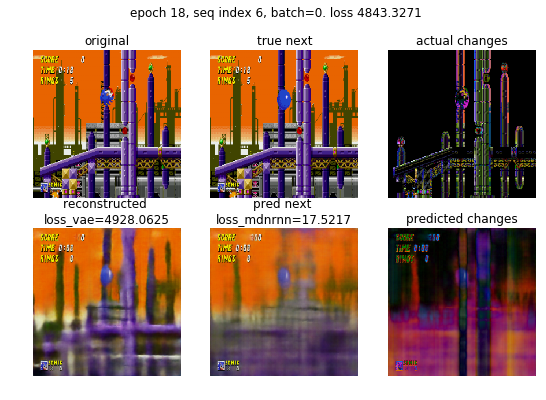

[0/1250] loss=45.4250, loss_rnn=17.3991, loss_inv= 0.7265=1* 0.7265, loss_vae=27.2994=0.0083 * (3275.10 + 0.15*|5.54 - 0|)
[400/1250] loss=34.4067, loss_rnn=17.2210, loss_inv= 0.7163=1* 0.7163, loss_vae=26.3537=0.0083 * (3161.54 + 0.15*|6.06 - 0|)
[800/1250] loss=67.6354, loss_rnn=17.1838, loss_inv= 0.7161=1* 0.7161, loss_vae=24.2853=0.0083 * (2913.34 + 0.15*|5.97 - 0|)
[1200/1250] loss=38.5288, loss_rnn=17.0805, loss_inv= 0.7161=1* 0.7161, loss_vae=22.0021=0.0083 * (2639.37 + 0.15*|5.89 - 0|)
loss=47.2984, loss_rnn=17.0768, loss_inv= 0.7160=1* 0.7160, loss_vae=21.7990=0.0083 * (2615.00 + 0.15*|5.90 - 0|)



[0/208] loss=38.3428, loss_rnn=17.1338, loss_inv= 0.7124=1* 0.7124, loss_vae=20.4966=0.0083 * (2458.88 + 0.15*|4.76 - 0|)
loss=38.3871, loss_rnn=17.1661, loss_inv= 0.7168=1* 0.7168, loss_vae=26.2057=0.0083 * (3143.77 + 0.15*|6.04 - 0|)

Epoch 19, loss=17.0768, loss_val=17.1661, loss_vae=2615.8809, loss_vae_val=3144.6809,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 8.0
finv loss 0.7266


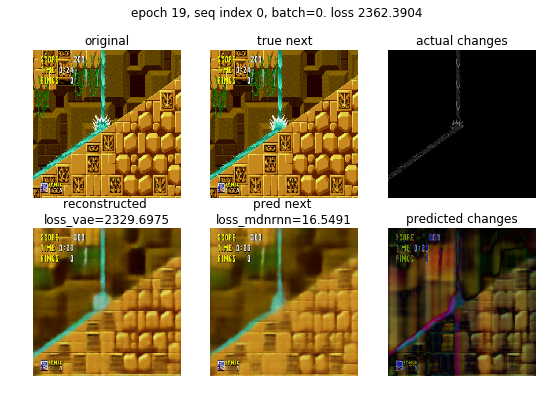

action_pred 2
action_true 9.0
finv loss 0.7266


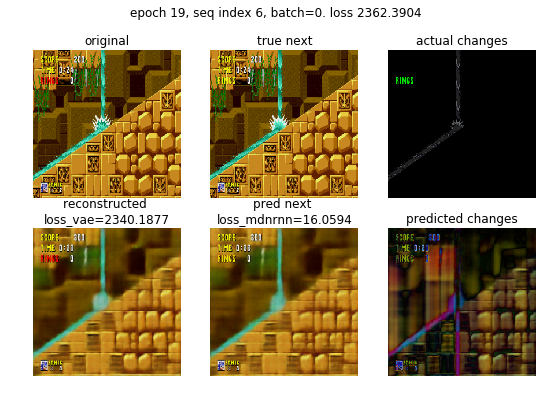

[0/1250] loss=41.8729, loss_rnn=16.6727, loss_inv= 0.7123=1* 0.7123, loss_vae=24.4879=0.0083 * (2937.63 + 0.15*|6.14 - 0|)
[400/1250] loss=44.4238, loss_rnn=17.0793, loss_inv= 0.7163=1* 0.7163, loss_vae=23.2541=0.0083 * (2789.62 + 0.15*|5.83 - 0|)
[800/1250] loss=50.7825, loss_rnn=17.0145, loss_inv= 0.7168=1* 0.7168, loss_vae=23.3337=0.0083 * (2799.21 + 0.15*|5.55 - 0|)
[1200/1250] loss=41.2338, loss_rnn=17.1070, loss_inv= 0.7164=1* 0.7164, loss_vae=24.4800=0.0083 * (2936.72 + 0.15*|5.85 - 0|)
loss=49.1583, loss_rnn=17.1050, loss_inv= 0.7164=1* 0.7164, loss_vae=24.3245=0.0083 * (2918.06 + 0.15*|5.87 - 0|)



[0/208] loss=60.0930, loss_rnn=17.6364, loss_inv= 0.7259=1* 0.7259, loss_vae=41.7307=0.0083 * (5006.62 + 0.15*|7.10 - 0|)
loss=42.6045, loss_rnn=17.1272, loss_inv= 0.7152=1* 0.7152, loss_vae=21.8769=0.0083 * (2624.39 + 0.15*|5.56 - 0|)

Epoch 20, loss=17.1050, loss_val=17.1272, loss_vae=2918.9373, loss_vae_val=2625.2278,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 8.0
finv loss 0.7265


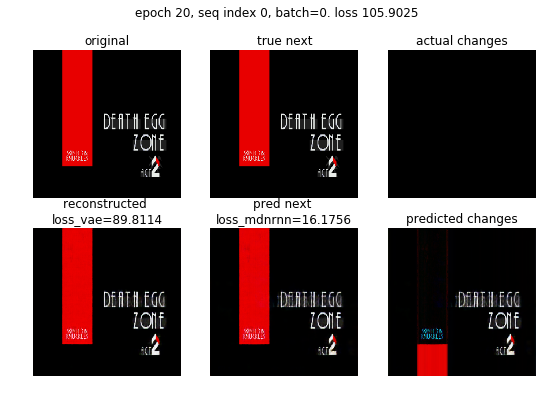

action_pred 2
action_true 5.0
finv loss 0.7265


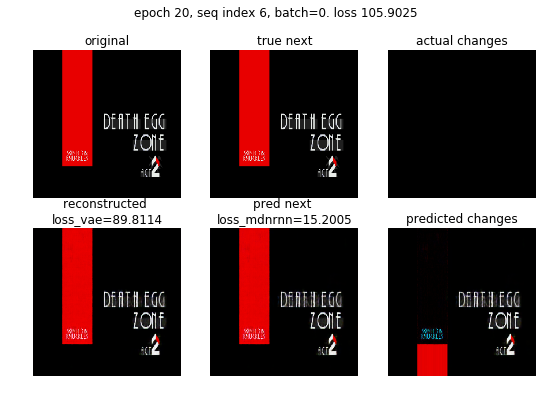

[0/1250] loss=50.7818, loss_rnn=17.3947, loss_inv= 0.7123=1* 0.7123, loss_vae=32.6748=0.0083 * (3919.76 + 0.15*|8.07 - 0|)
[400/1250] loss=30.9225, loss_rnn=16.9487, loss_inv= 0.7156=1* 0.7156, loss_vae=22.4094=0.0083 * (2688.22 + 0.15*|6.01 - 0|)
[800/1250] loss=45.6279, loss_rnn=16.9857, loss_inv= 0.7156=1* 0.7156, loss_vae=22.1785=0.0083 * (2660.55 + 0.15*|5.76 - 0|)
[1200/1250] loss=20.6595, loss_rnn=17.0427, loss_inv= 0.7156=1* 0.7156, loss_vae=23.2968=0.0083 * (2794.73 + 0.15*|5.86 - 0|)
loss=26.5651, loss_rnn=17.0271, loss_inv= 0.7156=1* 0.7156, loss_vae=23.0284=0.0083 * (2762.53 + 0.15*|5.83 - 0|)



[0/208] loss=36.6950, loss_rnn=16.3397, loss_inv= 0.7123=1* 0.7123, loss_vae=19.6431=0.0083 * (2356.51 + 0.15*|4.36 - 0|)
loss=39.1420, loss_rnn=17.2259, loss_inv= 0.7161=1* 0.7161, loss_vae=24.1113=0.0083 * (2892.45 + 0.15*|6.03 - 0|)

Epoch 21, loss=17.0271, loss_val=17.2259, loss_vae=2763.4067, loss_vae_val=2893.3552,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 5.0
finv loss 0.7266


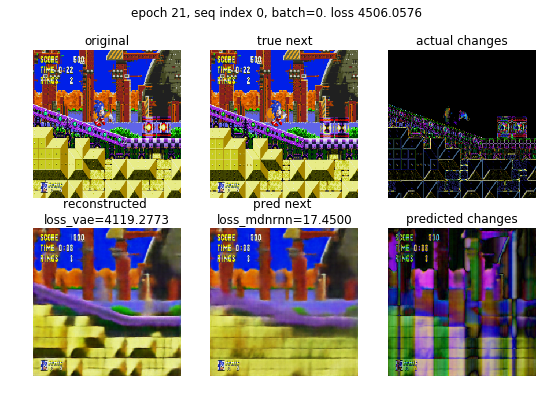

action_pred 2
action_true 3.0
finv loss 0.7266


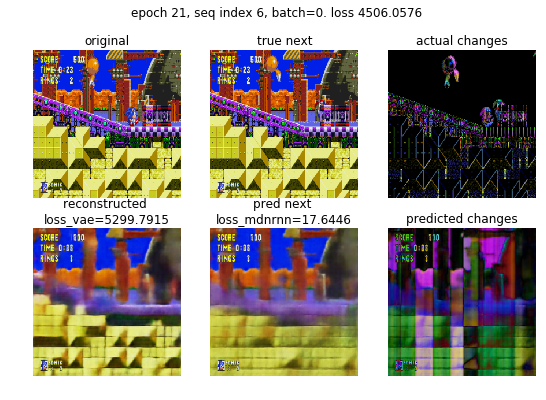

[0/1250] loss=51.1409, loss_rnn=17.5106, loss_inv= 0.6866=1* 0.6866, loss_vae=32.9438=0.0083 * (3952.05 + 0.15*|8.05 - 0|)
[400/1250] loss=23.3635, loss_rnn=17.0034, loss_inv= 0.7158=1* 0.7158, loss_vae=22.7926=0.0083 * (2734.20 + 0.15*|6.07 - 0|)
[800/1250] loss=35.2580, loss_rnn=17.0680, loss_inv= 0.7156=1* 0.7156, loss_vae=23.2484=0.0083 * (2788.94 + 0.15*|5.79 - 0|)
[1200/1250] loss=48.8951, loss_rnn=17.0277, loss_inv= 0.7157=1* 0.7157, loss_vae=21.3947=0.0083 * (2566.49 + 0.15*|5.78 - 0|)
loss=31.9694, loss_rnn=17.0402, loss_inv= 0.7158=1* 0.7158, loss_vae=21.6072=0.0083 * (2591.99 + 0.15*|5.85 - 0|)



[0/208] loss=30.1604, loss_rnn=17.3746, loss_inv= 0.7125=1* 0.7125, loss_vae=12.0732=0.0083 * (1447.71 + 0.15*|7.19 - 0|)
loss=75.9730, loss_rnn=17.3026, loss_inv= 0.7164=1* 0.7164, loss_vae=23.0370=0.0083 * (2763.52 + 0.15*|6.09 - 0|)

Epoch 22, loss=17.0402, loss_val=17.3026, loss_vae=2592.8665, loss_vae_val=2764.4358,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7123


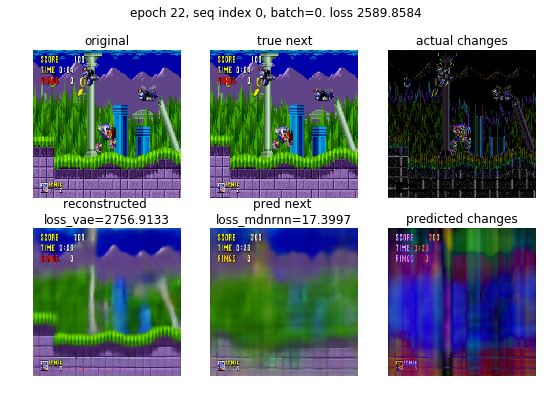

action_pred 2
action_true 2.0
finv loss 0.7123


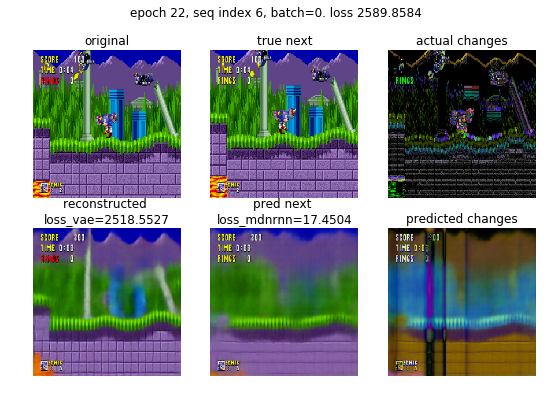

[0/1250] loss=40.2188, loss_rnn=17.3379, loss_inv= 0.7117=1* 0.7117, loss_vae=22.1693=0.0083 * (2659.61 + 0.15*|4.69 - 0|)
[400/1250] loss=34.7921, loss_rnn=17.0805, loss_inv= 0.7159=1* 0.7159, loss_vae=24.4074=0.0083 * (2928.07 + 0.15*|5.45 - 0|)
[800/1250] loss=54.9937, loss_rnn=17.0770, loss_inv= 0.7161=1* 0.7161, loss_vae=23.3443=0.0083 * (2800.46 + 0.15*|5.73 - 0|)
[1200/1250] loss=36.0165, loss_rnn=17.0999, loss_inv= 0.7162=1* 0.7162, loss_vae=23.0235=0.0083 * (2761.95 + 0.15*|5.80 - 0|)
loss=42.9392, loss_rnn=17.0991, loss_inv= 0.7161=1* 0.7161, loss_vae=22.9978=0.0083 * (2758.86 + 0.15*|5.81 - 0|)



[0/208] loss=36.8393, loss_rnn=16.9955, loss_inv= 0.7123=1* 0.7123, loss_vae=19.1315=0.0083 * (2295.26 + 0.15*|3.51 - 0|)
loss=31.5329, loss_rnn=17.2859, loss_inv= 0.7169=1* 0.7169, loss_vae=24.0439=0.0083 * (2884.36 + 0.15*|6.04 - 0|)

Epoch 23, loss=17.0991, loss_val=17.2859, loss_vae=2759.7368, loss_vae_val=2885.2632,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 7.0
finv loss 0.7123


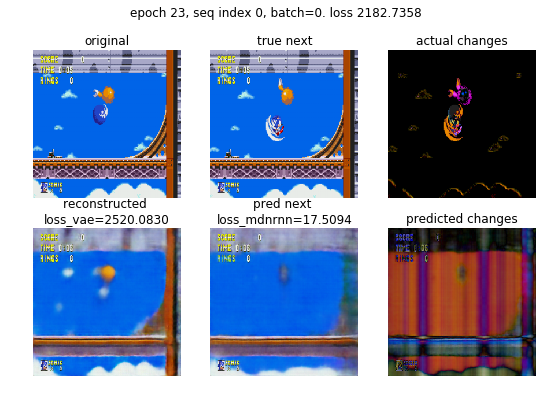

action_pred 2
action_true 5.0
finv loss 0.7123


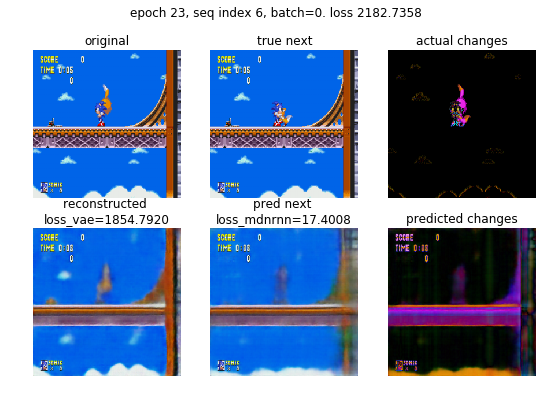

[0/1250] loss=36.1085, loss_rnn=17.3639, loss_inv= 0.6980=1* 0.6980, loss_vae=18.0466=0.0083 * (2164.75 + 0.15*|5.67 - 0|)
[400/1250] loss=70.1110, loss_rnn=16.9620, loss_inv= 0.7158=1* 0.7158, loss_vae=20.5171=0.0083 * (2461.22 + 0.15*|5.54 - 0|)
[800/1250] loss=15.1911, loss_rnn=17.0023, loss_inv= 0.7159=1* 0.7159, loss_vae=22.7656=0.0083 * (2731.02 + 0.15*|5.65 - 0|)
[1200/1250] loss=20.6987, loss_rnn=17.0297, loss_inv= 0.7159=1* 0.7159, loss_vae=23.2664=0.0083 * (2791.12 + 0.15*|5.68 - 0|)
loss=34.2407, loss_rnn=17.0282, loss_inv= 0.7159=1* 0.7159, loss_vae=22.9922=0.0083 * (2758.22 + 0.15*|5.65 - 0|)



[0/208] loss=51.0521, loss_rnn=17.2636, loss_inv= 0.7266=1* 0.7266, loss_vae=33.0619=0.0083 * (3966.65 + 0.15*|5.15 - 0|)
loss=43.2784, loss_rnn=17.1757, loss_inv= 0.7159=1* 0.7159, loss_vae=21.5555=0.0083 * (2585.92 + 0.15*|4.93 - 0|)

Epoch 24, loss=17.0282, loss_val=17.1757, loss_vae=2759.0696, loss_vae_val=2586.6599,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7123


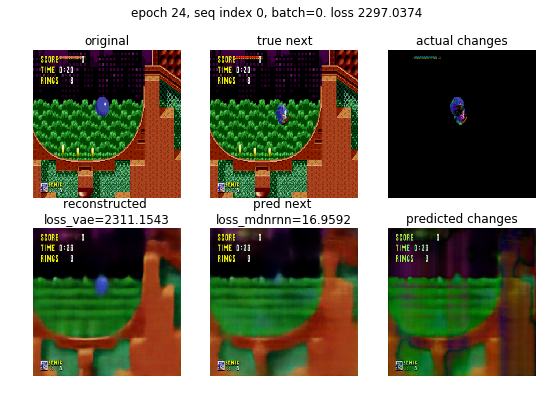

action_pred 2
action_true 2.0
finv loss 0.7123


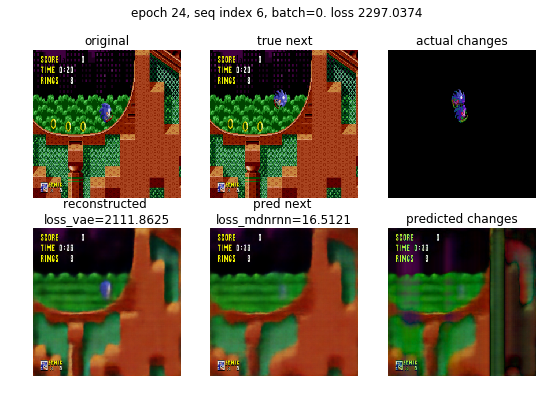

[0/1250] loss=57.9514, loss_rnn=17.5652, loss_inv= 0.7265=1* 0.7265, loss_vae=39.6597=0.0083 * (4758.29 + 0.15*|5.87 - 0|)
[400/1250] loss=40.5829, loss_rnn=17.2092, loss_inv= 0.7150=1* 0.7150, loss_vae=24.0969=0.0083 * (2890.77 + 0.15*|5.74 - 0|)
[800/1250] loss=28.4160, loss_rnn=17.1631, loss_inv= 0.7150=1* 0.7150, loss_vae=23.7026=0.0083 * (2843.44 + 0.15*|5.83 - 0|)
[1200/1250] loss=62.9745, loss_rnn=17.1455, loss_inv= 0.7154=1* 0.7154, loss_vae=23.8063=0.0083 * (2855.87 + 0.15*|5.89 - 0|)
loss=24.2782, loss_rnn=17.1535, loss_inv= 0.7154=1* 0.7154, loss_vae=24.5432=0.0083 * (2944.30 + 0.15*|5.91 - 0|)



[0/208] loss=16.4521, loss_rnn=15.0057, loss_inv= 0.7122=1* 0.7122, loss_vae=0.7341=0.0083 * (87.43 + 0.15*|4.43 - 0|)
loss=42.9084, loss_rnn=16.8731, loss_inv= 0.7153=1* 0.7153, loss_vae=20.4387=0.0083 * (2451.82 + 0.15*|5.55 - 0|)

Epoch 25, loss=17.1535, loss_val=16.8731, loss_vae=2945.1841, loss_vae_val=2452.6484,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7125


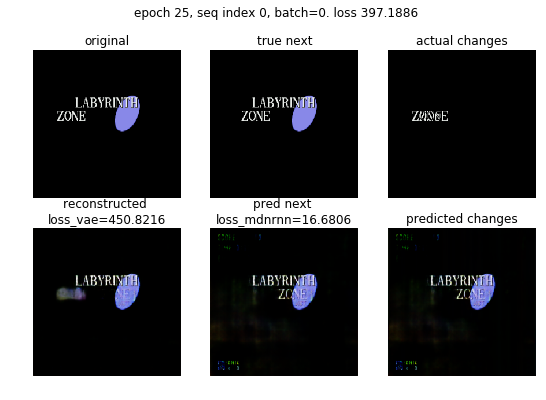

action_pred 2
action_true 2.0
finv loss 0.7125


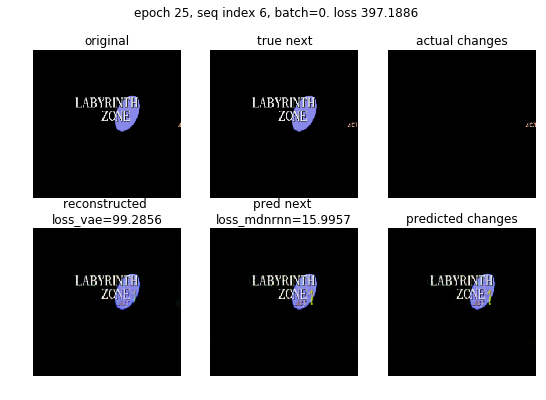

[0/1250] loss=41.2751, loss_rnn=17.2336, loss_inv= 0.7265=1* 0.7265, loss_vae=23.3150=0.0083 * (2797.14 + 0.15*|4.40 - 0|)
[400/1250] loss=37.2581, loss_rnn=17.1052, loss_inv= 0.7155=1* 0.7155, loss_vae=21.8902=0.0083 * (2626.02 + 0.15*|5.35 - 0|)
[800/1250] loss=38.3902, loss_rnn=17.1428, loss_inv= 0.7160=1* 0.7160, loss_vae=23.3076=0.0083 * (2796.04 + 0.15*|5.84 - 0|)
[1200/1250] loss=44.6255, loss_rnn=17.0731, loss_inv= 0.7159=1* 0.7159, loss_vae=21.9247=0.0083 * (2630.12 + 0.15*|5.67 - 0|)
loss=69.0586, loss_rnn=17.0926, loss_inv= 0.7160=1* 0.7160, loss_vae=22.2085=0.0083 * (2664.15 + 0.15*|5.77 - 0|)



[0/208] loss=34.1799, loss_rnn=16.7111, loss_inv= 0.6980=1* 0.6980, loss_vae=16.7708=0.0083 * (2011.82 + 0.15*|4.44 - 0|)
loss=33.9777, loss_rnn=17.3464, loss_inv= 0.7165=1* 0.7165, loss_vae=23.9179=0.0083 * (2869.22 + 0.15*|6.25 - 0|)

Epoch 26, loss=17.0926, loss_val=17.3464, loss_vae=2665.0198, loss_vae_val=2870.1533,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 8.0
finv loss 0.7266


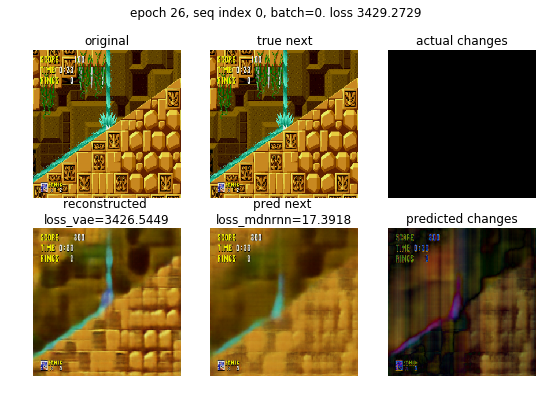

action_pred 2
action_true 8.0
finv loss 0.7266


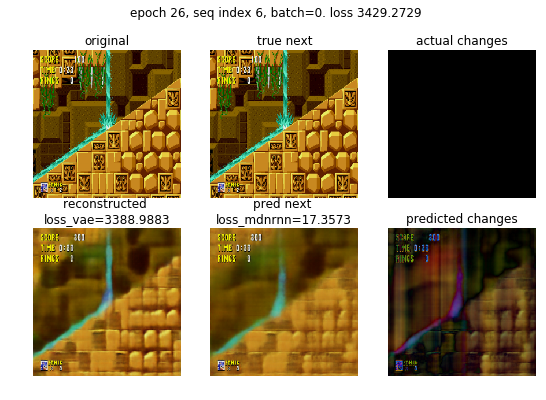

[0/1250] loss=38.5860, loss_rnn=16.4740, loss_inv= 0.7177=1* 0.7177, loss_vae=21.3942=0.0083 * (2566.48 + 0.15*|5.55 - 0|)
[400/1250] loss=52.5337, loss_rnn=17.0962, loss_inv= 0.7162=1* 0.7162, loss_vae=26.0602=0.0083 * (3126.33 + 0.15*|5.99 - 0|)
[800/1250] loss=23.2314, loss_rnn=17.0231, loss_inv= 0.7156=1* 0.7156, loss_vae=22.3715=0.0083 * (2683.70 + 0.15*|5.87 - 0|)
[1200/1250] loss=69.3906, loss_rnn=17.0392, loss_inv= 0.7158=1* 0.7158, loss_vae=21.9038=0.0083 * (2627.58 + 0.15*|5.84 - 0|)
loss=33.7656, loss_rnn=17.0447, loss_inv= 0.7158=1* 0.7158, loss_vae=22.3490=0.0083 * (2681.00 + 0.15*|5.89 - 0|)



[0/208] loss=18.1286, loss_rnn=15.3856, loss_inv= 0.7123=1* 0.7123, loss_vae=2.0307=0.0083 * (242.91 + 0.15*|5.12 - 0|)
loss=44.4386, loss_rnn=17.0857, loss_inv= 0.7154=1* 0.7154, loss_vae=19.8287=0.0083 * (2378.66 + 0.15*|5.27 - 0|)

Epoch 27, loss=17.0447, loss_val=17.0857, loss_vae=2681.8828, loss_vae_val=2379.4492,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 8.0
finv loss 0.7123


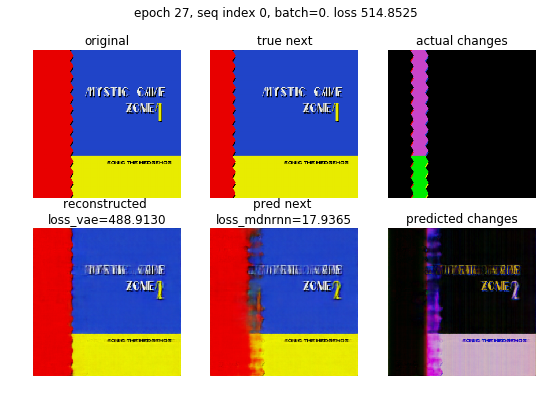

action_pred 2
action_true 0.0
finv loss 0.7123


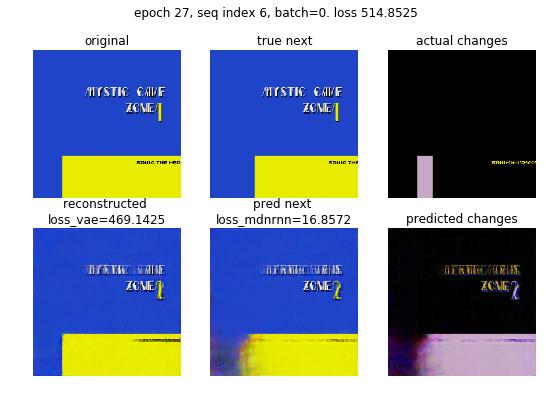

[0/1250] loss=49.1476, loss_rnn=17.0173, loss_inv= 0.7264=1* 0.7264, loss_vae=31.4038=0.0083 * (3767.60 + 0.15*|5.68 - 0|)
[400/1250] loss=40.0960, loss_rnn=16.7608, loss_inv= 0.7172=1* 0.7172, loss_vae=22.0791=0.0083 * (2648.70 + 0.15*|5.30 - 0|)
[800/1250] loss=73.6488, loss_rnn=16.8506, loss_inv= 0.7164=1* 0.7164, loss_vae=21.8007=0.0083 * (2615.27 + 0.15*|5.40 - 0|)
[1200/1250] loss=33.0914, loss_rnn=16.9759, loss_inv= 0.7164=1* 0.7164, loss_vae=21.9186=0.0083 * (2629.39 + 0.15*|5.65 - 0|)
loss=25.8764, loss_rnn=16.9684, loss_inv= 0.7163=1* 0.7163, loss_vae=21.5732=0.0083 * (2587.94 + 0.15*|5.64 - 0|)



[0/208] loss=36.8698, loss_rnn=17.3119, loss_inv= 0.7266=1* 0.7266, loss_vae=18.8313=0.0083 * (2258.95 + 0.15*|5.36 - 0|)
loss=37.9249, loss_rnn=17.1612, loss_inv= 0.7156=1* 0.7156, loss_vae=19.9835=0.0083 * (2397.20 + 0.15*|5.45 - 0|)

Epoch 28, loss=16.9684, loss_val=17.1612, loss_vae=2588.7822, loss_vae_val=2398.0229,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 8.0
finv loss 0.7123


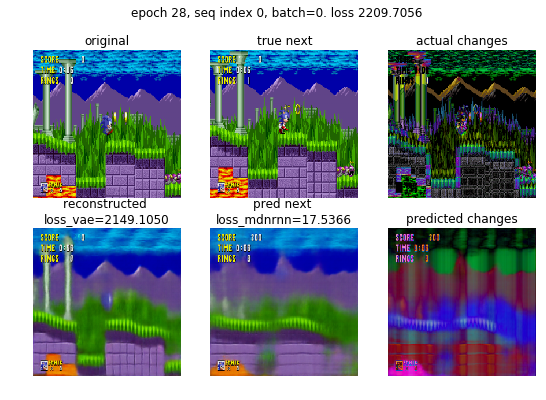

action_pred 2
action_true 7.0
finv loss 0.7123


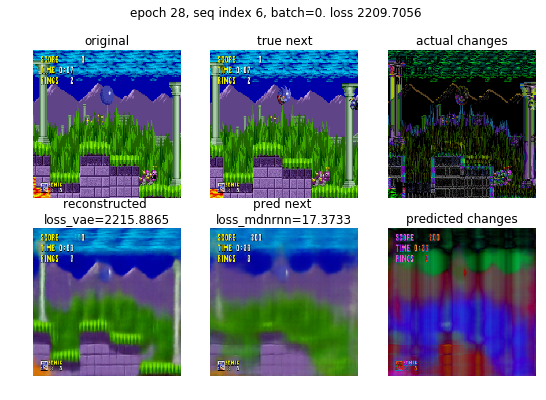

[0/1250] loss=29.0416, loss_rnn=17.1756, loss_inv= 0.7122=1* 0.7122, loss_vae=11.1538=0.0083 * (1337.66 + 0.15*|5.36 - 0|)
[400/1250] loss=46.8423, loss_rnn=17.2082, loss_inv= 0.7161=1* 0.7161, loss_vae=22.2968=0.0083 * (2674.70 + 0.15*|6.06 - 0|)
[800/1250] loss=35.4098, loss_rnn=17.0981, loss_inv= 0.7171=1* 0.7171, loss_vae=23.7278=0.0083 * (2846.47 + 0.15*|5.80 - 0|)
[1200/1250] loss=65.7176, loss_rnn=17.0493, loss_inv= 0.7167=1* 0.7167, loss_vae=21.6860=0.0083 * (2601.44 + 0.15*|5.82 - 0|)
loss=24.7785, loss_rnn=17.0448, loss_inv= 0.7167=1* 0.7167, loss_vae=21.9220=0.0083 * (2629.77 + 0.15*|5.81 - 0|)



[0/208] loss=74.0848, loss_rnn=17.8533, loss_inv= 0.7290=1* 0.7290, loss_vae=55.5025=0.0083 * (6659.22 + 0.15*|7.18 - 0|)
loss=36.2940, loss_rnn=17.4732, loss_inv= 0.7155=1* 0.7155, loss_vae=25.5539=0.0083 * (3065.50 + 0.15*|6.43 - 0|)

Epoch 29, loss=17.0448, loss_val=17.4732, loss_vae=2630.6399, loss_vae_val=3066.4636,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 4.0
finv loss 0.7266


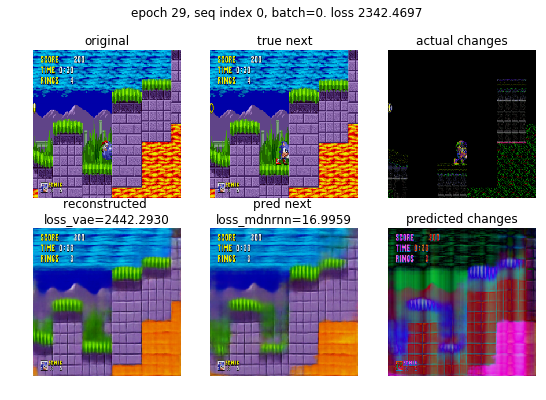

action_pred 2
action_true 5.0
finv loss 0.7266


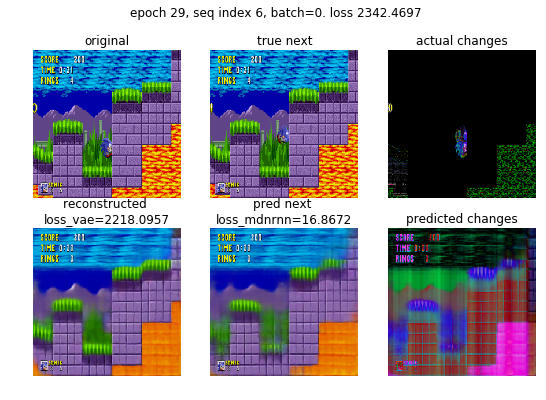

[0/1250] loss=40.1652, loss_rnn=17.4201, loss_inv= 0.7266=1* 0.7266, loss_vae=22.0185=0.0083 * (2641.31 + 0.15*|6.06 - 0|)
[400/1250] loss=25.1767, loss_rnn=16.9787, loss_inv= 0.7161=1* 0.7161, loss_vae=20.4309=0.0083 * (2450.86 + 0.15*|5.64 - 0|)
[800/1250] loss=31.9741, loss_rnn=16.9922, loss_inv= 0.7160=1* 0.7160, loss_vae=20.3237=0.0083 * (2438.01 + 0.15*|5.52 - 0|)
[1200/1250] loss=25.9691, loss_rnn=17.0540, loss_inv= 0.7160=1* 0.7160, loss_vae=21.1401=0.0083 * (2535.94 + 0.15*|5.75 - 0|)
loss=26.0207, loss_rnn=17.0386, loss_inv= 0.7160=1* 0.7160, loss_vae=20.8506=0.0083 * (2501.21 + 0.15*|5.76 - 0|)



[0/208] loss=52.8245, loss_rnn=17.5132, loss_inv= 0.7123=1* 0.7123, loss_vae=34.5990=0.0083 * (4150.67 + 0.15*|8.10 - 0|)
loss=30.5509, loss_rnn=17.3812, loss_inv= 0.7158=1* 0.7158, loss_vae=25.4878=0.0083 * (3057.59 + 0.15*|6.31 - 0|)

Epoch 30, loss=17.0386, loss_val=17.3812, loss_vae=2502.0735, loss_vae_val=3058.5374,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 4.0
finv loss 0.7119


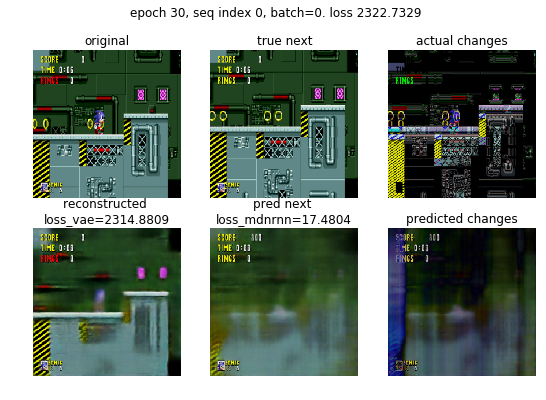

action_pred 2
action_true 2.0
finv loss 0.7119


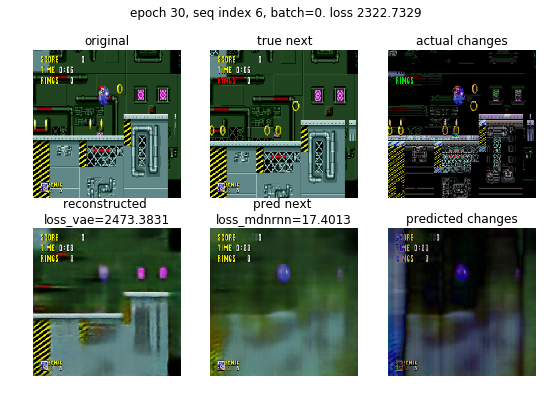

[0/1250] loss=69.4978, loss_rnn=17.6044, loss_inv= 0.7266=1* 0.7266, loss_vae=51.1668=0.0083 * (6139.13 + 0.15*|5.89 - 0|)
[400/1250] loss=30.9451, loss_rnn=16.8612, loss_inv= 0.7172=1* 0.7172, loss_vae=20.7135=0.0083 * (2484.80 + 0.15*|5.52 - 0|)
[800/1250] loss=23.0697, loss_rnn=16.8949, loss_inv= 0.7167=1* 0.7167, loss_vae=19.7634=0.0083 * (2370.77 + 0.15*|5.59 - 0|)
[1200/1250] loss=36.4394, loss_rnn=16.9492, loss_inv= 0.7163=1* 0.7163, loss_vae=20.2614=0.0083 * (2430.52 + 0.15*|5.69 - 0|)
loss=41.3174, loss_rnn=16.9487, loss_inv= 0.7163=1* 0.7163, loss_vae=20.3358=0.0083 * (2439.45 + 0.15*|5.66 - 0|)



[0/208] loss=15.2046, loss_rnn=14.4868, loss_inv= 0.7112=1* 0.7112, loss_vae=0.0066=0.0083 * (0.24 + 0.15*|3.64 - 0|)
loss=70.8590, loss_rnn=17.2020, loss_inv= 0.7152=1* 0.7152, loss_vae=23.8933=0.0083 * (2866.35 + 0.15*|5.62 - 0|)

Epoch 31, loss=16.9487, loss_val=17.2020, loss_vae=2440.2993, loss_vae_val=2867.1943,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 0.0
finv loss 0.6837


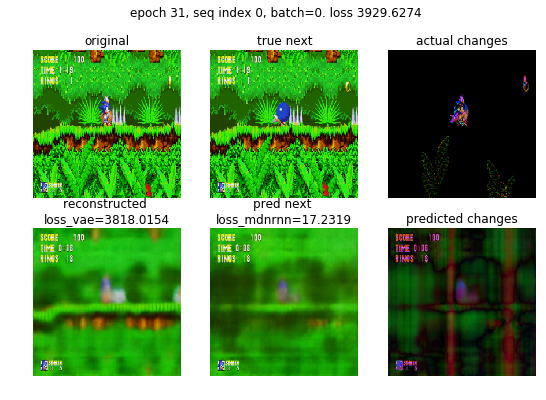

action_pred 2
action_true 2.0
finv loss 0.6837


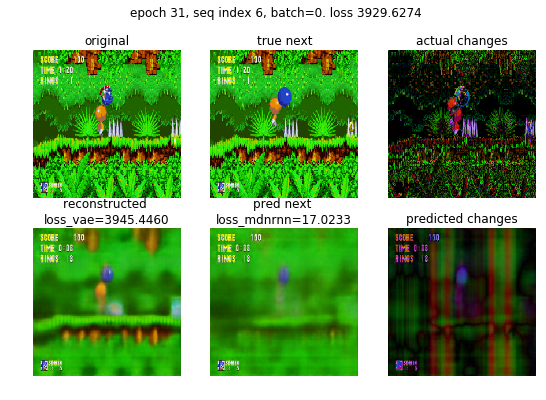

[0/1250] loss=49.7199, loss_rnn=17.4174, loss_inv= 0.7266=1* 0.7266, loss_vae=31.5759=0.0083 * (3788.18 + 0.15*|6.13 - 0|)
[400/1250] loss=30.7897, loss_rnn=17.1386, loss_inv= 0.7165=1* 0.7165, loss_vae=25.2957=0.0083 * (3034.61 + 0.15*|5.79 - 0|)
[800/1250] loss=25.6468, loss_rnn=17.1345, loss_inv= 0.7162=1* 0.7162, loss_vae=24.0675=0.0083 * (2887.21 + 0.15*|5.93 - 0|)
[1200/1250] loss=28.0110, loss_rnn=17.0555, loss_inv= 0.7162=1* 0.7162, loss_vae=21.7548=0.0083 * (2609.71 + 0.15*|5.77 - 0|)
loss=87.4870, loss_rnn=17.0491, loss_inv= 0.7161=1* 0.7161, loss_vae=21.8634=0.0083 * (2622.74 + 0.15*|5.77 - 0|)



[0/208] loss=19.3531, loss_rnn=16.3196, loss_inv= 0.7265=1* 0.7265, loss_vae=2.3070=0.0083 * (276.16 + 0.15*|4.53 - 0|)
loss=36.0794, loss_rnn=16.8244, loss_inv= 0.7160=1* 0.7160, loss_vae=16.7710=0.0083 * (2011.71 + 0.15*|5.38 - 0|)

Epoch 32, loss=17.0491, loss_val=16.8244, loss_vae=2623.6094, loss_vae_val=2012.5195,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  8,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7117


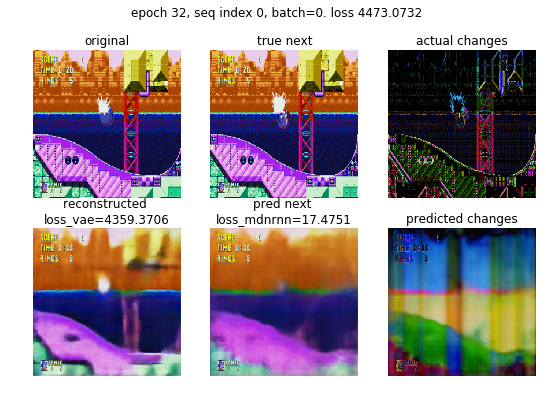

action_pred 2
action_true 2.0
finv loss 0.7117


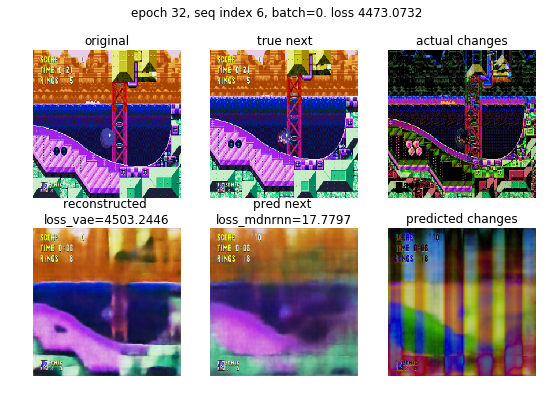

[0/1250] loss=40.4638, loss_rnn=17.5113, loss_inv= 0.7270=1* 0.7270, loss_vae=22.2254=0.0083 * (2666.35 + 0.15*|4.63 - 0|)
[400/1250] loss=46.9043, loss_rnn=16.9391, loss_inv= 0.7161=1* 0.7161, loss_vae=20.8302=0.0083 * (2498.79 + 0.15*|5.62 - 0|)
[800/1250] loss=38.4185, loss_rnn=16.9922, loss_inv= 0.7159=1* 0.7159, loss_vae=23.0108=0.0083 * (2760.44 + 0.15*|5.76 - 0|)
[1200/1250] loss=44.4696, loss_rnn=17.0159, loss_inv= 0.7157=1* 0.7157, loss_vae=22.4241=0.0083 * (2690.03 + 0.15*|5.78 - 0|)
loss=25.4083, loss_rnn=17.0179, loss_inv= 0.7157=1* 0.7157, loss_vae=22.6697=0.0083 * (2719.50 + 0.15*|5.78 - 0|)



[0/208] loss=35.9134, loss_rnn=17.5009, loss_inv= 0.7283=1* 0.7283, loss_vae=17.6842=0.0083 * (2120.98 + 0.15*|7.48 - 0|)
loss=38.3482, loss_rnn=17.3288, loss_inv= 0.7154=1* 0.7154, loss_vae=25.0696=0.0083 * (3007.45 + 0.15*|6.03 - 0|)

Epoch 33, loss=17.0179, loss_val=17.3288, loss_vae=2720.3672, loss_vae_val=3008.3540,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 9.0
finv loss 0.7244


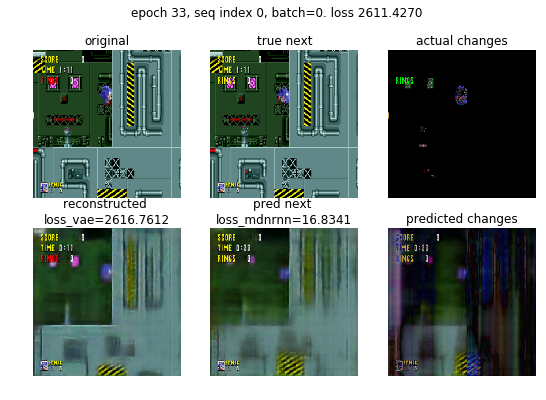

action_pred 2
action_true 8.0
finv loss 0.7244


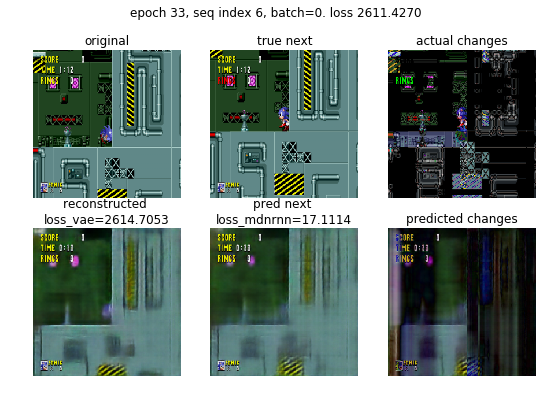

[0/1250] loss=43.4834, loss_rnn=17.1193, loss_inv= 0.6980=1* 0.6980, loss_vae=25.6661=0.0083 * (3079.36 + 0.15*|3.83 - 0|)
[400/1250] loss=29.1455, loss_rnn=17.1336, loss_inv= 0.7161=1* 0.7161, loss_vae=25.5270=0.0083 * (3062.40 + 0.15*|5.61 - 0|)
[800/1250] loss=37.0001, loss_rnn=17.0565, loss_inv= 0.7169=1* 0.7169, loss_vae=23.8508=0.0083 * (2861.26 + 0.15*|5.55 - 0|)
[1200/1250] loss=45.9912, loss_rnn=17.0205, loss_inv= 0.7167=1* 0.7167, loss_vae=23.4135=0.0083 * (2808.76 + 0.15*|5.71 - 0|)
loss=56.6560, loss_rnn=17.0247, loss_inv= 0.7167=1* 0.7167, loss_vae=23.6627=0.0083 * (2838.67 + 0.15*|5.70 - 0|)



[0/208] loss=65.7654, loss_rnn=17.5065, loss_inv= 0.6981=1* 0.6981, loss_vae=47.5607=0.0083 * (5706.40 + 0.15*|5.91 - 0|)
loss=38.4838, loss_rnn=17.1746, loss_inv= 0.7156=1* 0.7156, loss_vae=26.1932=0.0083 * (3142.35 + 0.15*|5.59 - 0|)

Epoch 34, loss=17.0247, loss_val=17.1746, loss_vae=2839.5273, loss_vae_val=3143.1851,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 4.0
finv loss 0.7104


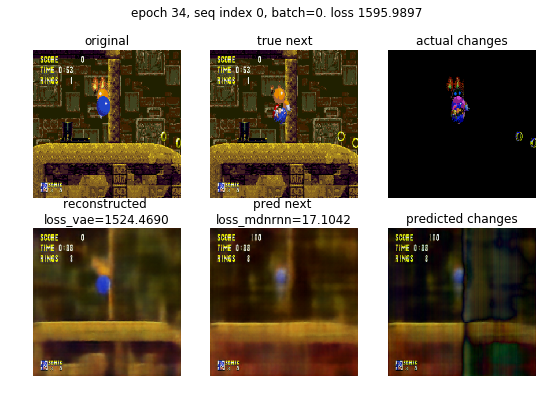

action_pred 2
action_true 8.0
finv loss 0.7104


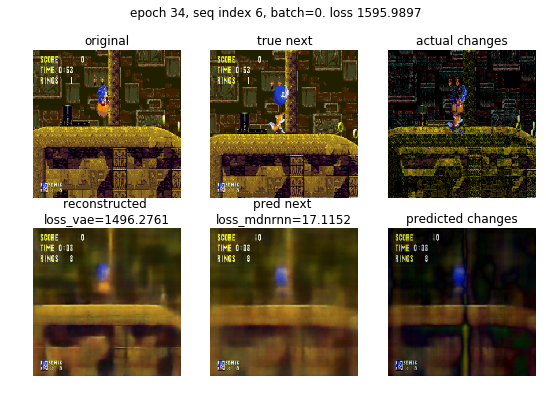

[0/1250] loss=38.0722, loss_rnn=17.5384, loss_inv= 0.7123=1* 0.7123, loss_vae=19.8216=0.0083 * (2377.45 + 0.15*|7.56 - 0|)
[400/1250] loss=36.6334, loss_rnn=17.0537, loss_inv= 0.7160=1* 0.7160, loss_vae=19.6067=0.0083 * (2351.94 + 0.15*|5.82 - 0|)
[800/1250] loss=56.1928, loss_rnn=17.0239, loss_inv= 0.7172=1* 0.7172, loss_vae=20.8647=0.0083 * (2502.92 + 0.15*|5.64 - 0|)
[1200/1250] loss=60.0491, loss_rnn=17.0109, loss_inv= 0.7166=1* 0.7166, loss_vae=22.1981=0.0083 * (2662.91 + 0.15*|5.70 - 0|)
loss=39.1704, loss_rnn=17.0126, loss_inv= 0.7166=1* 0.7166, loss_vae=22.4382=0.0083 * (2691.74 + 0.15*|5.68 - 0|)



[0/208] loss=43.3104, loss_rnn=17.4511, loss_inv= 0.7266=1* 0.7266, loss_vae=25.1328=0.0083 * (3014.89 + 0.15*|6.95 - 0|)
loss=41.0025, loss_rnn=17.3694, loss_inv= 0.7163=1* 0.7163, loss_vae=23.9135=0.0083 * (2868.72 + 0.15*|5.98 - 0|)

Epoch 35, loss=17.0126, loss_val=17.3694, loss_vae=2692.5872, loss_vae_val=2869.6208,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7123


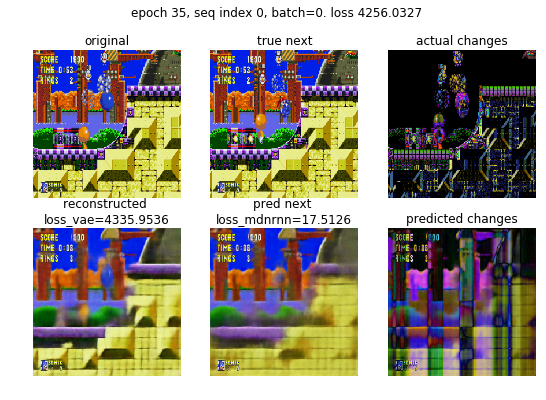

action_pred 2
action_true 6.0
finv loss 0.7123


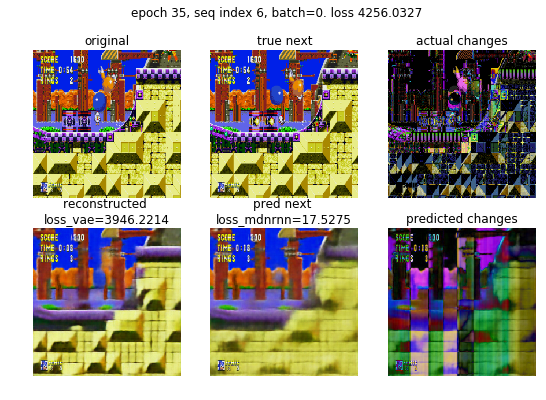

[0/1250] loss=35.9319, loss_rnn=16.0654, loss_inv= 0.7266=1* 0.7266, loss_vae=19.1400=0.0083 * (2296.10 + 0.15*|4.62 - 0|)
[400/1250] loss=35.2734, loss_rnn=16.8819, loss_inv= 0.7152=1* 0.7152, loss_vae=23.1241=0.0083 * (2774.02 + 0.15*|5.81 - 0|)
[800/1250] loss=85.0518, loss_rnn=16.9980, loss_inv= 0.7157=1* 0.7157, loss_vae=25.6879=0.0083 * (3081.65 + 0.15*|6.02 - 0|)
[1200/1250] loss=34.4623, loss_rnn=17.0072, loss_inv= 0.7157=1* 0.7157, loss_vae=25.0245=0.0083 * (3002.05 + 0.15*|5.97 - 0|)
loss=36.8955, loss_rnn=16.9999, loss_inv= 0.7158=1* 0.7158, loss_vae=24.7030=0.0083 * (2963.47 + 0.15*|5.96 - 0|)



[0/208] loss=37.4577, loss_rnn=17.2427, loss_inv= 0.7123=1* 0.7123, loss_vae=19.5027=0.0083 * (2339.69 + 0.15*|4.19 - 0|)
loss=33.8134, loss_rnn=17.1811, loss_inv= 0.7159=1* 0.7159, loss_vae=20.8760=0.0083 * (2504.39 + 0.15*|4.84 - 0|)

Epoch 36, loss=16.9999, loss_val=17.1811, loss_vae=2964.3645, loss_vae_val=2505.1187,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7123


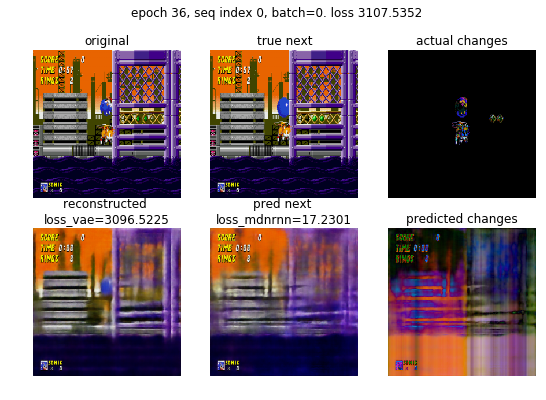

action_pred 2
action_true 2.0
finv loss 0.7123


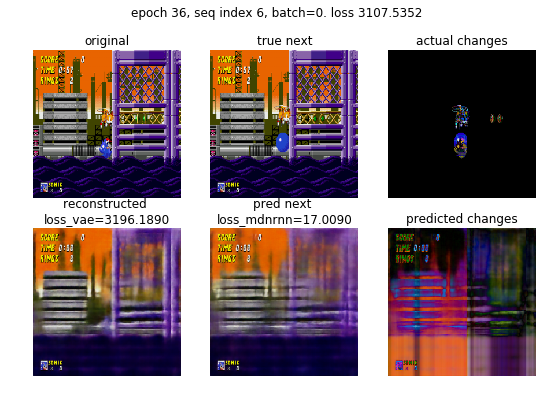

[0/1250] loss=42.1397, loss_rnn=16.5128, loss_inv= 0.7266=1* 0.7266, loss_vae=24.9004=0.0083 * (2987.13 + 0.15*|6.12 - 0|)
[400/1250] loss=23.9555, loss_rnn=17.0831, loss_inv= 0.7158=1* 0.7158, loss_vae=26.4712=0.0083 * (3175.62 + 0.15*|6.16 - 0|)
[800/1250] loss=45.3863, loss_rnn=17.1130, loss_inv= 0.7160=1* 0.7160, loss_vae=26.8575=0.0083 * (3222.01 + 0.15*|5.99 - 0|)
[1200/1250] loss=46.1580, loss_rnn=17.0705, loss_inv= 0.7160=1* 0.7160, loss_vae=24.6645=0.0083 * (2958.84 + 0.15*|5.99 - 0|)
loss=67.5792, loss_rnn=17.0783, loss_inv= 0.7160=1* 0.7160, loss_vae=24.9264=0.0083 * (2990.27 + 0.15*|6.00 - 0|)



[0/208] loss=41.1101, loss_rnn=17.3706, loss_inv= 0.7265=1* 0.7265, loss_vae=23.0129=0.0083 * (2760.58 + 0.15*|6.50 - 0|)
loss=38.0316, loss_rnn=17.2281, loss_inv= 0.7165=1* 0.7165, loss_vae=20.8785=0.0083 * (2504.51 + 0.15*|6.06 - 0|)

Epoch 37, loss=17.0783, loss_val=17.2281, loss_vae=2991.1655, loss_vae_val=2505.4185,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7124


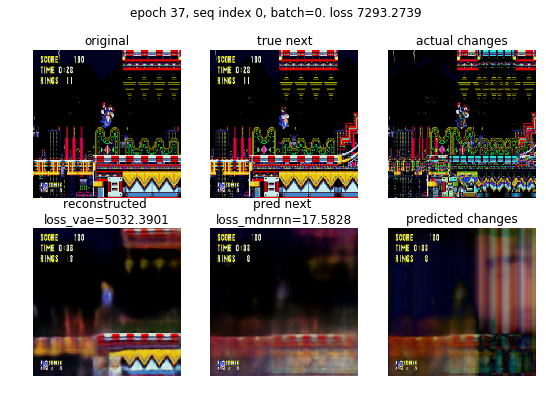

action_pred 2
action_true 2.0
finv loss 0.7124


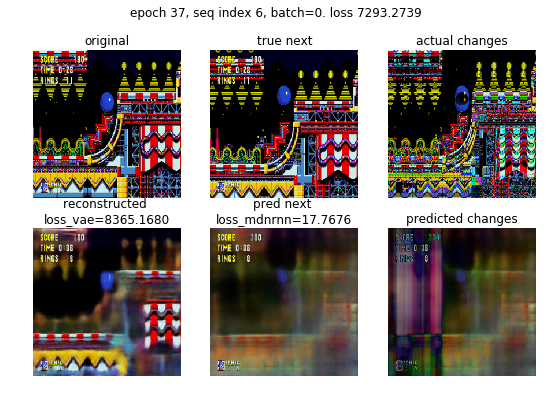

[0/1250] loss=20.7799, loss_rnn=16.5893, loss_inv= 0.7123=1* 0.7123, loss_vae=3.4783=0.0083 * (416.70 + 0.15*|4.62 - 0|)
[400/1250] loss=34.7078, loss_rnn=17.0482, loss_inv= 0.7163=1* 0.7163, loss_vae=22.8326=0.0083 * (2739.05 + 0.15*|5.77 - 0|)
[800/1250] loss=91.1022, loss_rnn=17.0295, loss_inv= 0.7163=1* 0.7163, loss_vae=22.5003=0.0083 * (2699.16 + 0.15*|5.85 - 0|)
[1200/1250] loss=25.1363, loss_rnn=17.0668, loss_inv= 0.7161=1* 0.7161, loss_vae=23.9602=0.0083 * (2874.37 + 0.15*|5.71 - 0|)
loss=40.8161, loss_rnn=17.0671, loss_inv= 0.7161=1* 0.7161, loss_vae=23.7516=0.0083 * (2849.34 + 0.15*|5.69 - 0|)



[0/208] loss=18.6171, loss_rnn=16.0204, loss_inv= 0.7266=1* 0.7266, loss_vae=1.8702=0.0083 * (223.74 + 0.15*|4.51 - 0|)
loss=40.9573, loss_rnn=17.1131, loss_inv= 0.7149=1* 0.7149, loss_vae=22.0612=0.0083 * (2646.54 + 0.15*|5.33 - 0|)

Epoch 38, loss=17.0671, loss_val=17.1131, loss_vae=2850.1968, loss_vae_val=2647.3413,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7123


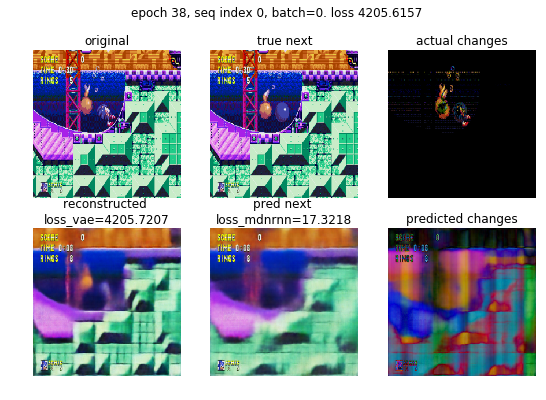

action_pred 2
action_true 2.0
finv loss 0.7123


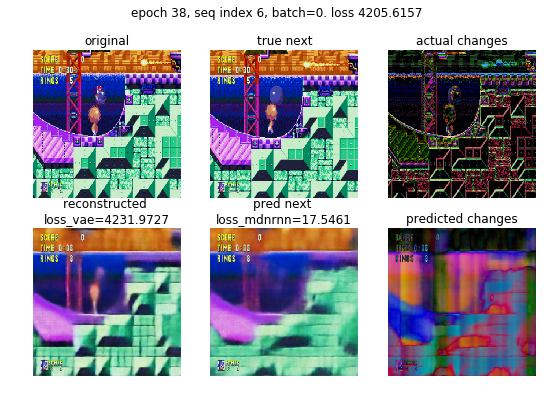

[0/1250] loss=15.3702, loss_rnn=14.6482, loss_inv= 0.7149=1* 0.7149, loss_vae=0.0070=0.0083 * (0.30 + 0.15*|3.62 - 0|)
[400/1250] loss=21.0595, loss_rnn=17.0156, loss_inv= 0.7157=1* 0.7157, loss_vae=20.2981=0.0083 * (2434.96 + 0.15*|5.41 - 0|)
[800/1250] loss=47.8574, loss_rnn=16.9854, loss_inv= 0.7159=1* 0.7159, loss_vae=19.8235=0.0083 * (2378.01 + 0.15*|5.41 - 0|)
[1200/1250] loss=48.4016, loss_rnn=16.9671, loss_inv= 0.7162=1* 0.7162, loss_vae=20.4068=0.0083 * (2448.00 + 0.15*|5.46 - 0|)
loss=68.8701, loss_rnn=16.9791, loss_inv= 0.7161=1* 0.7161, loss_vae=20.6735=0.0083 * (2480.00 + 0.15*|5.51 - 0|)



[0/208] loss=39.8427, loss_rnn=17.3894, loss_inv= 0.7266=1* 0.7266, loss_vae=21.7267=0.0083 * (2606.00 + 0.15*|8.00 - 0|)
loss=35.5668, loss_rnn=17.2723, loss_inv= 0.7151=1* 0.7151, loss_vae=24.1952=0.0083 * (2902.57 + 0.15*|5.69 - 0|)

Epoch 39, loss=16.9791, loss_val=17.2723, loss_vae=2480.8240, loss_vae_val=2903.4189,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7123


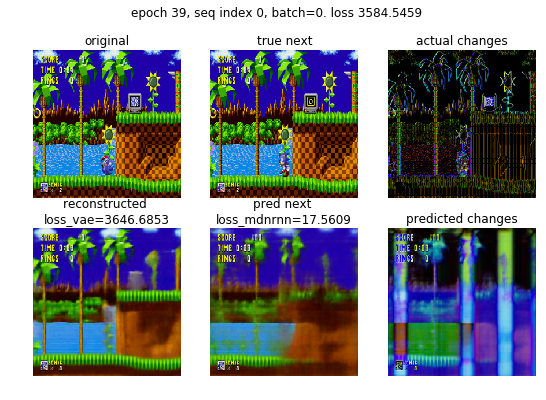

action_pred 2
action_true 2.0
finv loss 0.7123


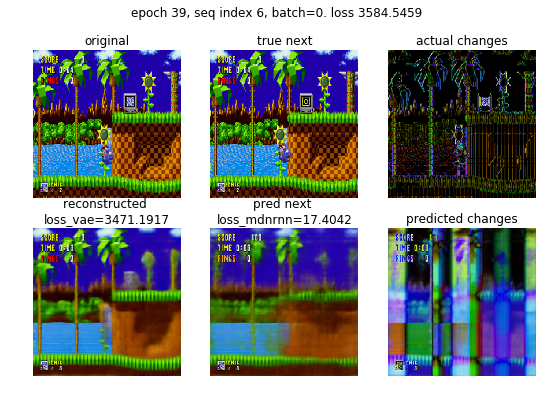

[0/1250] loss=35.1055, loss_rnn=17.2184, loss_inv= 0.7111=1* 0.7111, loss_vae=17.1760=0.0083 * (2060.43 + 0.15*|4.61 - 0|)
[400/1250] loss=43.2433, loss_rnn=17.1170, loss_inv= 0.7160=1* 0.7160, loss_vae=23.0923=0.0083 * (2770.18 + 0.15*|6.00 - 0|)
[800/1250] loss=29.1469, loss_rnn=17.0028, loss_inv= 0.7161=1* 0.7161, loss_vae=21.7774=0.0083 * (2612.44 + 0.15*|5.66 - 0|)
[1200/1250] loss=44.3820, loss_rnn=17.0183, loss_inv= 0.7157=1* 0.7157, loss_vae=23.1087=0.0083 * (2772.18 + 0.15*|5.72 - 0|)
loss=37.4267, loss_rnn=17.0291, loss_inv= 0.7158=1* 0.7158, loss_vae=23.2470=0.0083 * (2788.78 + 0.15*|5.73 - 0|)



[0/208] loss=41.0824, loss_rnn=17.4447, loss_inv= 0.7123=1* 0.7123, loss_vae=22.9253=0.0083 * (2750.17 + 0.15*|5.79 - 0|)
loss=53.6653, loss_rnn=17.1295, loss_inv= 0.7166=1* 0.7166, loss_vae=18.5701=0.0083 * (2227.61 + 0.15*|5.38 - 0|)

Epoch 40, loss=17.0291, loss_val=17.1295, loss_vae=2789.6379, loss_vae_val=2228.4146,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7125


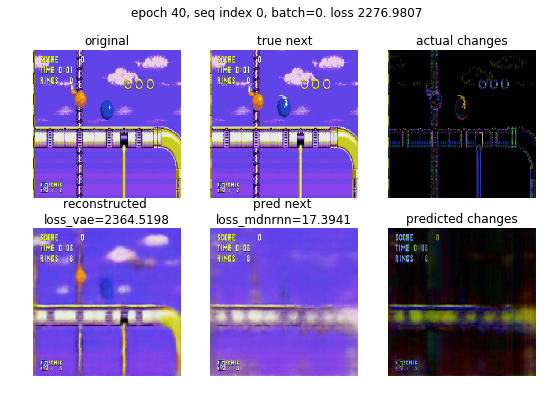

action_pred 2
action_true 2.0
finv loss 0.7125


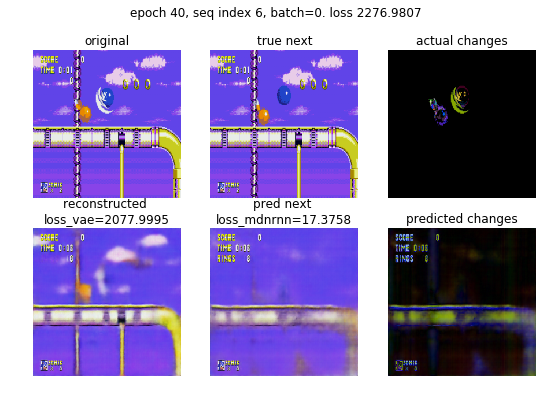

[0/1250] loss=44.4243, loss_rnn=17.0413, loss_inv= 0.7266=1* 0.7266, loss_vae=26.6564=0.0083 * (3198.21 + 0.15*|3.71 - 0|)
[400/1250] loss=41.5446, loss_rnn=17.1312, loss_inv= 0.7157=1* 0.7157, loss_vae=24.4753=0.0083 * (2936.19 + 0.15*|5.62 - 0|)
[800/1250] loss=37.0751, loss_rnn=16.9535, loss_inv= 0.7161=1* 0.7161, loss_vae=20.7218=0.0083 * (2485.80 + 0.15*|5.45 - 0|)
[1200/1250] loss=29.6260, loss_rnn=16.8646, loss_inv= 0.7157=1* 0.7157, loss_vae=19.3563=0.0083 * (2321.93 + 0.15*|5.51 - 0|)
loss=73.7910, loss_rnn=16.8658, loss_inv= 0.7156=1* 0.7156, loss_vae=19.4354=0.0083 * (2331.41 + 0.15*|5.56 - 0|)



[0/208] loss=67.4135, loss_rnn=17.3350, loss_inv= 0.7123=1* 0.7123, loss_vae=49.3662=0.0083 * (5922.72 + 0.15*|8.11 - 0|)
loss=29.0247, loss_rnn=17.2451, loss_inv= 0.7163=1* 0.7163, loss_vae=25.4412=0.0083 * (3052.03 + 0.15*|6.09 - 0|)

Epoch    45: reducing learning rate of group 0 to 1.0000e-07.
Epoch 41, loss=16.8658, loss_val=17.2451, loss_vae=2332.2424, loss_vae_val=3052.9482,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 6.0
finv loss 0.7267


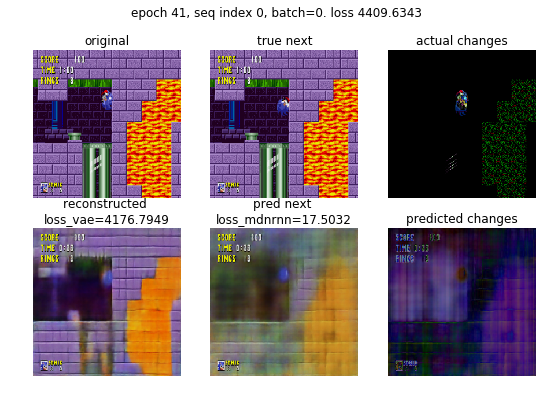

action_pred 2
action_true 8.0
finv loss 0.7267


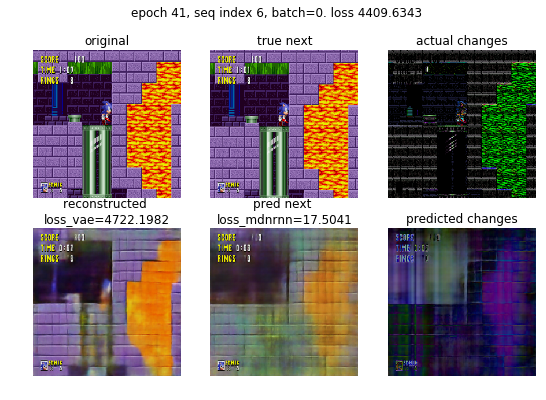

[0/1250] loss=32.2775, loss_rnn=17.2530, loss_inv= 0.6980=1* 0.6980, loss_vae=14.3265=0.0083 * (1718.39 + 0.15*|5.27 - 0|)
[400/1250] loss=58.5313, loss_rnn=17.0509, loss_inv= 0.7163=1* 0.7163, loss_vae=25.9928=0.0083 * (3118.24 + 0.15*|5.98 - 0|)
[800/1250] loss=30.4614, loss_rnn=17.0660, loss_inv= 0.7159=1* 0.7159, loss_vae=25.7145=0.0083 * (3084.86 + 0.15*|5.87 - 0|)
[1200/1250] loss=43.0504, loss_rnn=17.0881, loss_inv= 0.7157=1* 0.7157, loss_vae=25.0578=0.0083 * (3006.06 + 0.15*|5.81 - 0|)
loss=48.1814, loss_rnn=17.0849, loss_inv= 0.7157=1* 0.7157, loss_vae=25.0349=0.0083 * (3003.31 + 0.15*|5.81 - 0|)



[0/208] loss=50.9019, loss_rnn=17.6003, loss_inv= 0.7253=1* 0.7253, loss_vae=32.5763=0.0083 * (3907.91 + 0.15*|8.32 - 0|)
loss=44.0131, loss_rnn=17.3685, loss_inv= 0.7163=1* 0.7163, loss_vae=28.1180=0.0083 * (3373.26 + 0.15*|6.01 - 0|)

Epoch 42, loss=17.0849, loss_val=17.3685, loss_vae=3004.1853, loss_vae_val=3374.1611,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 8.0
finv loss 0.7264


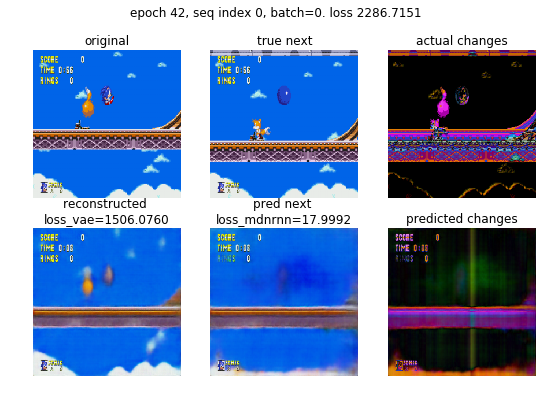

action_pred 2
action_true 8.0
finv loss 0.7264


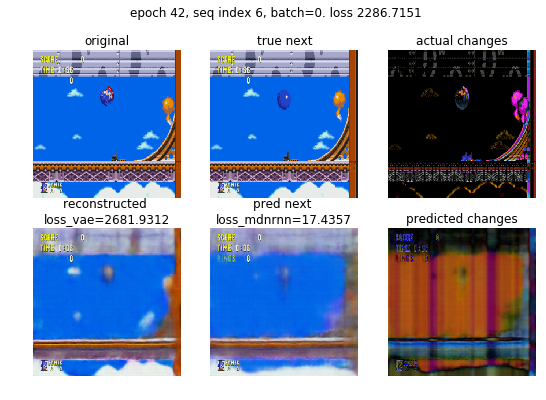

[0/1250] loss=39.3053, loss_rnn=16.6871, loss_inv= 0.7262=1* 0.7262, loss_vae=21.8920=0.0083 * (2626.03 + 0.15*|6.71 - 0|)
[400/1250] loss=39.9360, loss_rnn=17.0687, loss_inv= 0.7160=1* 0.7160, loss_vae=21.6302=0.0083 * (2594.79 + 0.15*|5.53 - 0|)
[800/1250] loss=14.9034, loss_rnn=17.0551, loss_inv= 0.7161=1* 0.7161, loss_vae=19.9221=0.0083 * (2389.82 + 0.15*|5.58 - 0|)
[1200/1250] loss=67.4901, loss_rnn=16.9777, loss_inv= 0.7165=1* 0.7165, loss_vae=19.5775=0.0083 * (2348.46 + 0.15*|5.57 - 0|)
loss=33.6700, loss_rnn=16.9833, loss_inv= 0.7165=1* 0.7165, loss_vae=19.9214=0.0083 * (2389.73 + 0.15*|5.59 - 0|)



[0/208] loss=53.9524, loss_rnn=17.5380, loss_inv= 0.7264=1* 0.7264, loss_vae=35.6880=0.0083 * (4281.68 + 0.15*|5.86 - 0|)
loss=37.7409, loss_rnn=17.2394, loss_inv= 0.7171=1* 0.7171, loss_vae=23.1382=0.0083 * (2775.83 + 0.15*|5.09 - 0|)

Epoch 43, loss=16.9833, loss_val=17.2394, loss_vae=2390.5645, loss_vae_val=2776.5901,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 6.0
finv loss 0.7266


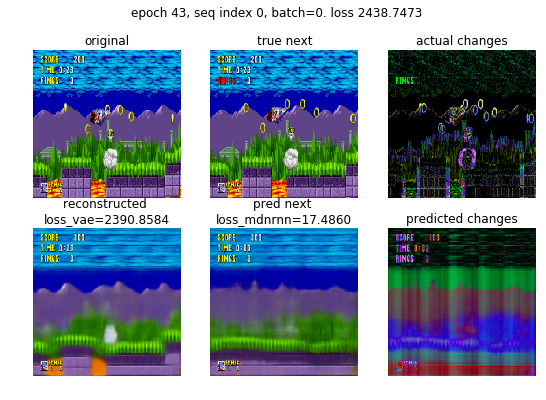

action_pred 2
action_true 4.0
finv loss 0.7266


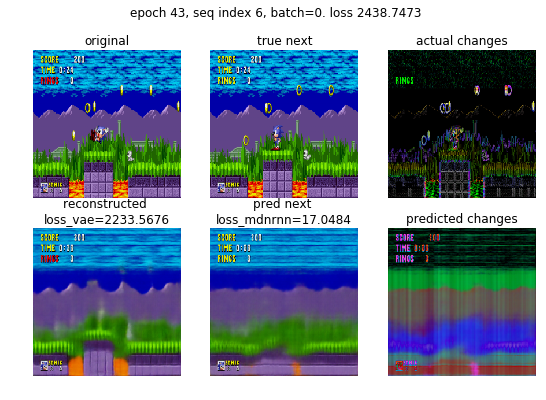

[0/1250] loss=34.1795, loss_rnn=17.3195, loss_inv= 0.7266=1* 0.7266, loss_vae=16.1334=0.0083 * (1935.13 + 0.15*|5.88 - 0|)
[400/1250] loss=17.4342, loss_rnn=16.8518, loss_inv= 0.7151=1* 0.7151, loss_vae=17.3165=0.0083 * (2077.20 + 0.15*|5.21 - 0|)
[800/1250] loss=37.4118, loss_rnn=17.0173, loss_inv= 0.7157=1* 0.7157, loss_vae=20.3516=0.0083 * (2441.38 + 0.15*|5.45 - 0|)
[1200/1250] loss=70.9899, loss_rnn=17.0294, loss_inv= 0.7158=1* 0.7158, loss_vae=20.9825=0.0083 * (2517.08 + 0.15*|5.50 - 0|)
loss=37.7474, loss_rnn=17.0184, loss_inv= 0.7158=1* 0.7158, loss_vae=20.9104=0.0083 * (2508.43 + 0.15*|5.51 - 0|)



[0/208] loss=62.0280, loss_rnn=17.6198, loss_inv= 0.6980=1* 0.6980, loss_vae=43.7101=0.0083 * (5244.02 + 0.15*|7.94 - 0|)
loss=42.9877, loss_rnn=17.1273, loss_inv= 0.7153=1* 0.7153, loss_vae=24.8291=0.0083 * (2978.60 + 0.15*|5.92 - 0|)

Epoch 44, loss=17.0184, loss_val=17.1273, loss_vae=2509.2539, loss_vae_val=2979.4893,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7123


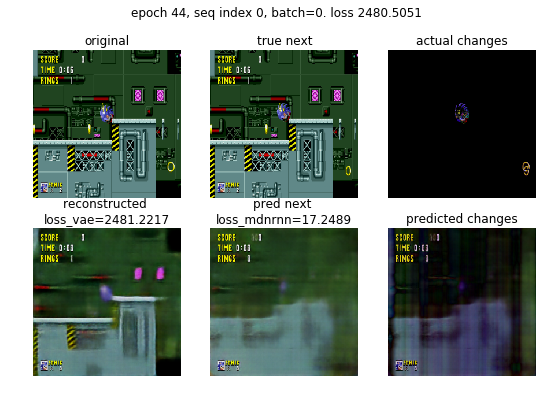

action_pred 2
action_true 2.0
finv loss 0.7123


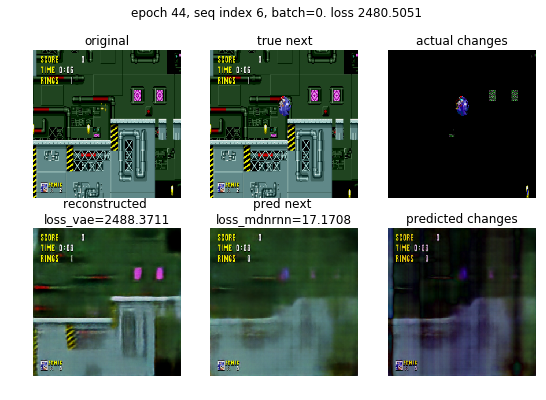

[0/1250] loss=31.6207, loss_rnn=16.7258, loss_inv= 0.7124=1* 0.7124, loss_vae=14.1824=0.0083 * (1701.06 + 0.15*|5.51 - 0|)
[400/1250] loss=44.0710, loss_rnn=17.0341, loss_inv= 0.7164=1* 0.7164, loss_vae=24.4142=0.0083 * (2928.85 + 0.15*|5.64 - 0|)
[800/1250] loss=40.2208, loss_rnn=17.0091, loss_inv= 0.7161=1* 0.7161, loss_vae=23.0904=0.0083 * (2769.99 + 0.15*|5.74 - 0|)
[1200/1250] loss=23.3905, loss_rnn=17.0045, loss_inv= 0.7163=1* 0.7163, loss_vae=22.4766=0.0083 * (2696.33 + 0.15*|5.79 - 0|)
loss=45.4993, loss_rnn=17.0115, loss_inv= 0.7162=1* 0.7162, loss_vae=22.4843=0.0083 * (2697.25 + 0.15*|5.80 - 0|)



[0/208] loss=42.7264, loss_rnn=17.4089, loss_inv= 0.7266=1* 0.7266, loss_vae=24.5909=0.0083 * (2949.89 + 0.15*|6.77 - 0|)
loss=38.8265, loss_rnn=17.0532, loss_inv= 0.7162=1* 0.7162, loss_vae=19.7729=0.0083 * (2371.90 + 0.15*|5.68 - 0|)

Epoch 45, loss=17.0115, loss_val=17.0532, loss_vae=2698.1160, loss_vae_val=2372.7488,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.6973


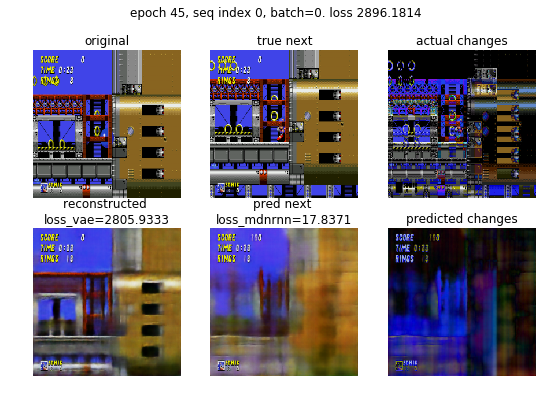

action_pred 2
action_true 2.0
finv loss 0.6973


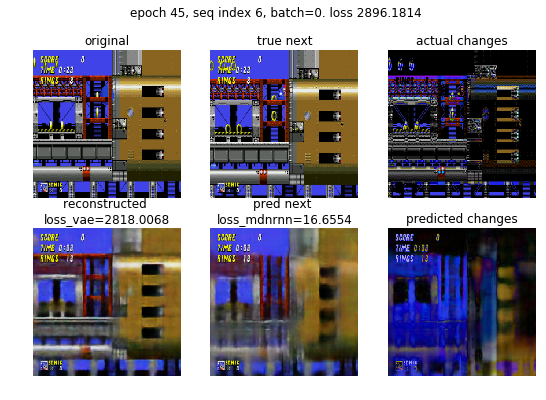

[0/1250] loss=62.6572, loss_rnn=16.9525, loss_inv= 0.7257=1* 0.7257, loss_vae=44.9789=0.0083 * (5396.50 + 0.15*|6.43 - 0|)
[400/1250] loss=46.7162, loss_rnn=17.0512, loss_inv= 0.7169=1* 0.7169, loss_vae=23.0374=0.0083 * (2763.60 + 0.15*|5.94 - 0|)
[800/1250] loss=32.7306, loss_rnn=17.0138, loss_inv= 0.7164=1* 0.7164, loss_vae=22.5690=0.0083 * (2707.40 + 0.15*|5.87 - 0|)
[1200/1250] loss=37.7565, loss_rnn=17.0579, loss_inv= 0.7162=1* 0.7162, loss_vae=23.5746=0.0083 * (2828.08 + 0.15*|5.83 - 0|)
loss=48.9156, loss_rnn=17.0568, loss_inv= 0.7162=1* 0.7162, loss_vae=23.3983=0.0083 * (2806.92 + 0.15*|5.82 - 0|)



[0/208] loss=49.2841, loss_rnn=17.3436, loss_inv= 0.7124=1* 0.7124, loss_vae=31.2281=0.0083 * (3746.17 + 0.15*|8.03 - 0|)
loss=17.2382, loss_rnn=17.2386, loss_inv= 0.7154=1* 0.7154, loss_vae=24.8411=0.0083 * (2980.09 + 0.15*|5.61 - 0|)

Epoch 46, loss=17.0568, loss_val=17.2386, loss_vae=2807.7927, loss_vae_val=2980.9270,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.6980


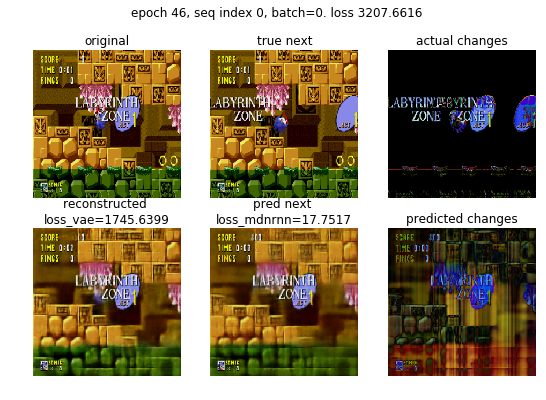

action_pred 2
action_true 2.0
finv loss 0.6980


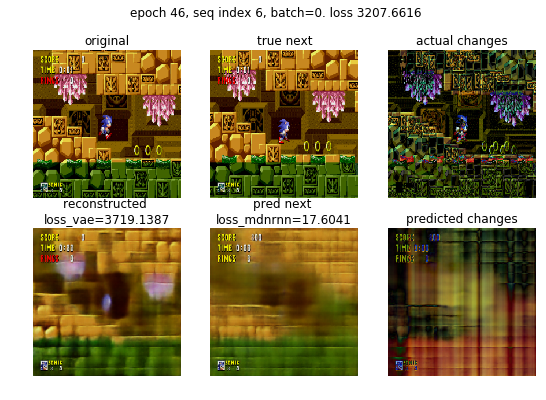

[0/1250] loss=28.2844, loss_rnn=17.1654, loss_inv= 0.7123=1* 0.7123, loss_vae=10.4067=0.0083 * (1247.85 + 0.15*|6.34 - 0|)
[400/1250] loss=52.4717, loss_rnn=16.9592, loss_inv= 0.7150=1* 0.7150, loss_vae=21.3252=0.0083 * (2558.17 + 0.15*|5.63 - 0|)
[800/1250] loss=38.4078, loss_rnn=16.9752, loss_inv= 0.7157=1* 0.7157, loss_vae=23.0732=0.0083 * (2767.97 + 0.15*|5.49 - 0|)
[1200/1250] loss=38.9569, loss_rnn=16.9633, loss_inv= 0.7158=1* 0.7158, loss_vae=22.2808=0.0083 * (2672.86 + 0.15*|5.55 - 0|)
loss=67.1715, loss_rnn=16.9586, loss_inv= 0.7157=1* 0.7157, loss_vae=22.3052=0.0083 * (2675.79 + 0.15*|5.58 - 0|)



[0/208] loss=21.9566, loss_rnn=15.6454, loss_inv= 0.7123=1* 0.7123, loss_vae=5.5989=0.0083 * (671.08 + 0.15*|5.25 - 0|)
loss=29.2893, loss_rnn=16.9554, loss_inv= 0.7162=1* 0.7162, loss_vae=18.9619=0.0083 * (2274.63 + 0.15*|5.30 - 0|)

Epoch 47, loss=16.9586, loss_val=16.9554, loss_vae=2676.6289, loss_vae_val=2275.4260,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7118


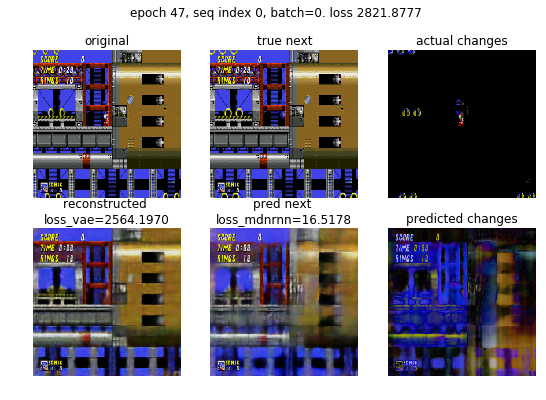

action_pred 2
action_true 2.0
finv loss 0.7118


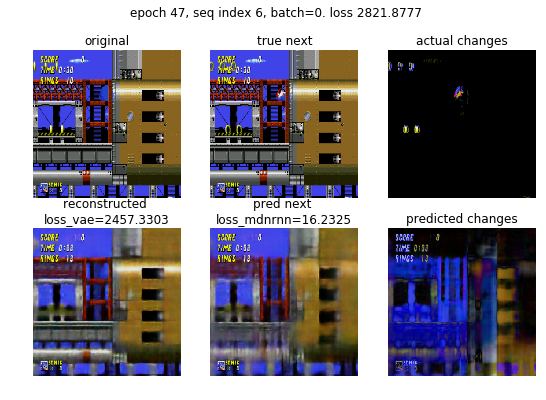

[0/1250] loss=18.4415, loss_rnn=17.4877, loss_inv= 0.6982=1* 0.6982, loss_vae=0.2556=0.0083 * (29.98 + 0.15*|4.58 - 0|)
[400/1250] loss=32.2109, loss_rnn=16.9923, loss_inv= 0.7154=1* 0.7154, loss_vae=20.8347=0.0083 * (2499.31 + 0.15*|5.67 - 0|)
[800/1250] loss=39.0457, loss_rnn=16.9866, loss_inv= 0.7155=1* 0.7155, loss_vae=20.2591=0.0083 * (2430.24 + 0.15*|5.67 - 0|)
[1200/1250] loss=16.6916, loss_rnn=17.0304, loss_inv= 0.7157=1* 0.7157, loss_vae=22.0124=0.0083 * (2640.61 + 0.15*|5.85 - 0|)
loss=42.1753, loss_rnn=17.0089, loss_inv= 0.7158=1* 0.7158, loss_vae=21.7739=0.0083 * (2612.00 + 0.15*|5.81 - 0|)



[0/208] loss=18.3077, loss_rnn=15.9603, loss_inv= 0.7266=1* 0.7266, loss_vae=1.6207=0.0083 * (193.79 + 0.15*|4.60 - 0|)
loss=34.9608, loss_rnn=17.1251, loss_inv= 0.7160=1* 0.7160, loss_vae=21.6814=0.0083 * (2600.95 + 0.15*|5.50 - 0|)

Epoch 48, loss=17.0089, loss_val=17.1251, loss_vae=2612.8691, loss_vae_val=2601.7717,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7003


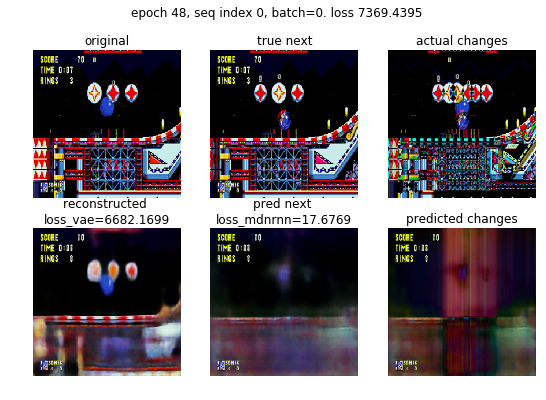

action_pred 2
action_true 2.0
finv loss 0.7003


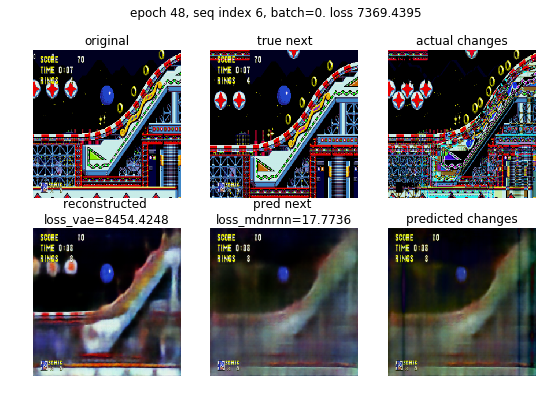

[0/1250] loss=48.9492, loss_rnn=16.9820, loss_inv= 0.7266=1* 0.7266, loss_vae=31.2406=0.0083 * (3747.60 + 0.15*|8.48 - 0|)
[400/1250] loss=35.7315, loss_rnn=17.1715, loss_inv= 0.7162=1* 0.7162, loss_vae=22.7504=0.0083 * (2729.13 + 0.15*|6.17 - 0|)
[800/1250] loss=31.7677, loss_rnn=17.1445, loss_inv= 0.7170=1* 0.7170, loss_vae=24.1142=0.0083 * (2892.80 + 0.15*|6.04 - 0|)
[1200/1250] loss=70.2989, loss_rnn=17.1043, loss_inv= 0.7165=1* 0.7165, loss_vae=23.0160=0.0083 * (2761.03 + 0.15*|5.91 - 0|)
loss=37.8177, loss_rnn=17.1120, loss_inv= 0.7165=1* 0.7165, loss_vae=23.1166=0.0083 * (2773.10 + 0.15*|5.93 - 0|)



[0/208] loss=15.9903, loss_rnn=14.3764, loss_inv= 0.6980=1* 0.6980, loss_vae=0.9159=0.0083 * (109.23 + 0.15*|4.49 - 0|)
loss=52.6089, loss_rnn=17.2145, loss_inv= 0.7156=1* 0.7156, loss_vae=24.6362=0.0083 * (2955.49 + 0.15*|5.66 - 0|)

Epoch 49, loss=17.1120, loss_val=17.2145, loss_vae=2773.9939, loss_vae_val=2956.3416,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 8.0
finv loss 0.7257


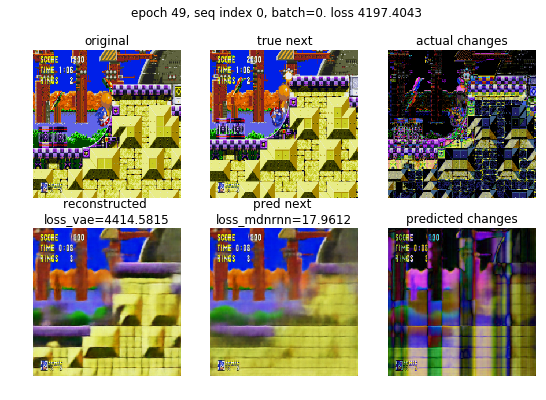

action_pred 2
action_true 8.0
finv loss 0.7257


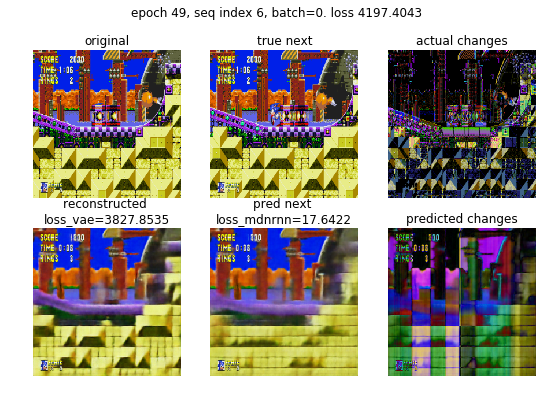

[0/1250] loss=64.0443, loss_rnn=17.4679, loss_inv= 0.6979=1* 0.6979, loss_vae=45.8784=0.0083 * (5504.49 + 0.15*|6.11 - 0|)
[400/1250] loss=27.8747, loss_rnn=17.1919, loss_inv= 0.7156=1* 0.7156, loss_vae=26.8973=0.0083 * (3226.76 + 0.15*|6.12 - 0|)
[800/1250] loss=32.6446, loss_rnn=17.1705, loss_inv= 0.7160=1* 0.7160, loss_vae=26.8273=0.0083 * (3218.36 + 0.15*|6.09 - 0|)
[1200/1250] loss=48.5721, loss_rnn=17.0901, loss_inv= 0.7162=1* 0.7162, loss_vae=24.8246=0.0083 * (2978.08 + 0.15*|5.82 - 0|)
loss=33.8163, loss_rnn=17.0730, loss_inv= 0.7162=1* 0.7162, loss_vae=24.6508=0.0083 * (2957.23 + 0.15*|5.79 - 0|)



[0/208] loss=41.2677, loss_rnn=17.3926, loss_inv= 0.7123=1* 0.7123, loss_vae=23.1628=0.0083 * (2778.77 + 0.15*|5.10 - 0|)
loss=66.2095, loss_rnn=17.3183, loss_inv= 0.7157=1* 0.7157, loss_vae=23.0786=0.0083 * (2768.53 + 0.15*|6.00 - 0|)

Epoch    54: reducing learning rate of group 0 to 1.0000e-08.
Epoch 50, loss=17.0730, loss_val=17.3183, loss_vae=2958.0950, loss_vae_val=2769.4336,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 3.0
finv loss 0.7266


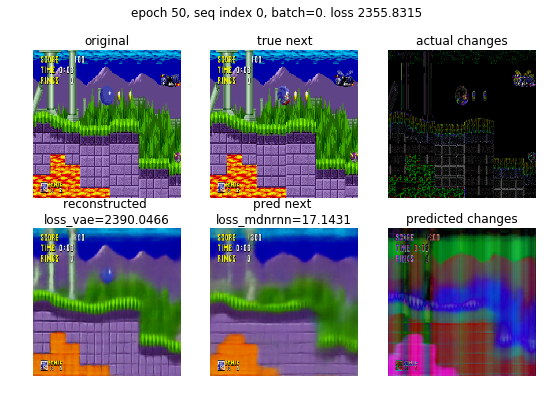

action_pred 2
action_true 0.0
finv loss 0.7266


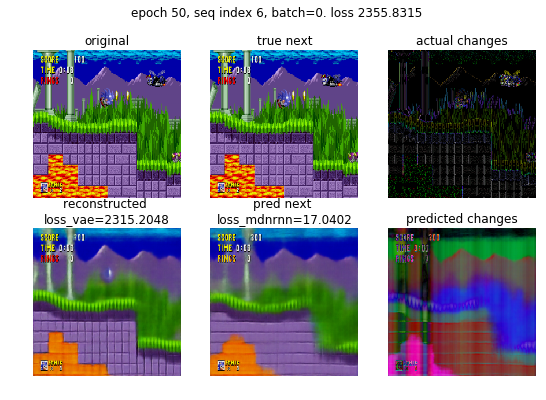

[0/1250] loss=35.2710, loss_rnn=17.4518, loss_inv= 0.7265=1* 0.7265, loss_vae=17.0927=0.0083 * (2050.20 + 0.15*|6.13 - 0|)
[400/1250] loss=17.2134, loss_rnn=16.9270, loss_inv= 0.7163=1* 0.7163, loss_vae=21.9000=0.0083 * (2627.17 + 0.15*|5.57 - 0|)
[800/1250] loss=38.5167, loss_rnn=16.8969, loss_inv= 0.7161=1* 0.7161, loss_vae=21.9511=0.0083 * (2633.30 + 0.15*|5.52 - 0|)
[1200/1250] loss=57.6928, loss_rnn=16.9649, loss_inv= 0.7162=1* 0.7162, loss_vae=22.7843=0.0083 * (2733.26 + 0.15*|5.69 - 0|)
loss=49.6556, loss_rnn=16.9767, loss_inv= 0.7162=1* 0.7162, loss_vae=23.2032=0.0083 * (2783.53 + 0.15*|5.68 - 0|)



[0/208] loss=45.9295, loss_rnn=17.5116, loss_inv= 0.7266=1* 0.7266, loss_vae=27.6914=0.0083 * (3321.74 + 0.15*|8.13 - 0|)
loss=68.1477, loss_rnn=17.2339, loss_inv= 0.7162=1* 0.7162, loss_vae=25.4499=0.0083 * (3053.07 + 0.15*|6.12 - 0|)

Epoch 51, loss=16.9767, loss_val=17.2339, loss_vae=2784.3782, loss_vae_val=3053.9922,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 8.0
finv loss 0.6837


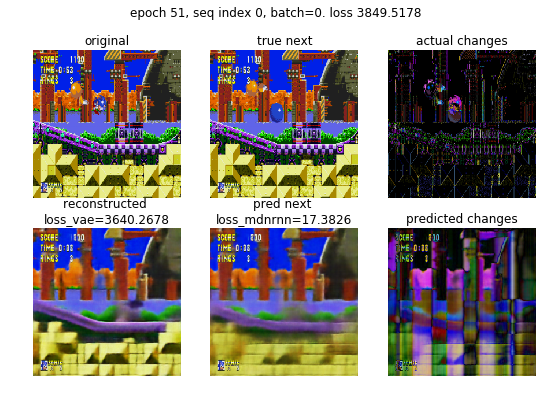

action_pred 2
action_true 8.0
finv loss 0.6837


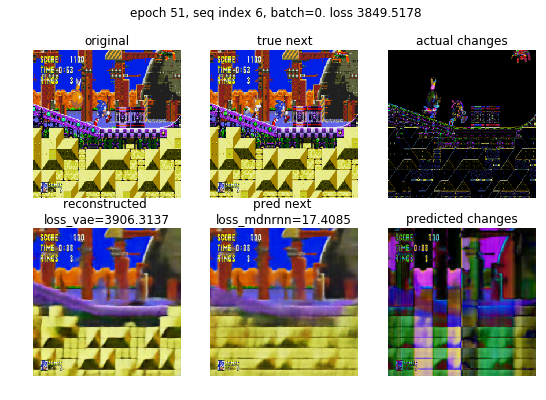

[0/1250] loss=34.8683, loss_rnn=16.9250, loss_inv= 0.6981=1* 0.6981, loss_vae=17.2452=0.0083 * (2068.64 + 0.15*|5.21 - 0|)
[400/1250] loss=15.1446, loss_rnn=16.8662, loss_inv= 0.7166=1* 0.7166, loss_vae=20.4825=0.0083 * (2457.06 + 0.15*|5.57 - 0|)
[800/1250] loss=52.4415, loss_rnn=16.9330, loss_inv= 0.7161=1* 0.7161, loss_vae=22.0796=0.0083 * (2648.71 + 0.15*|5.63 - 0|)
[1200/1250] loss=43.7493, loss_rnn=16.9957, loss_inv= 0.7162=1* 0.7162, loss_vae=22.7534=0.0083 * (2729.55 + 0.15*|5.74 - 0|)
loss=22.9033, loss_rnn=17.0044, loss_inv= 0.7162=1* 0.7162, loss_vae=22.6445=0.0083 * (2716.47 + 0.15*|5.75 - 0|)



[0/208] loss=43.5076, loss_rnn=16.9735, loss_inv= 0.7266=1* 0.7266, loss_vae=25.8075=0.0083 * (3096.06 + 0.15*|5.57 - 0|)
loss=21.7846, loss_rnn=17.1782, loss_inv= 0.7164=1* 0.7164, loss_vae=22.4112=0.0083 * (2688.48 + 0.15*|5.77 - 0|)

Epoch 52, loss=17.0044, loss_val=17.1782, loss_vae=2717.3374, loss_vae_val=2689.3494,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 2.0
finv loss 0.7119


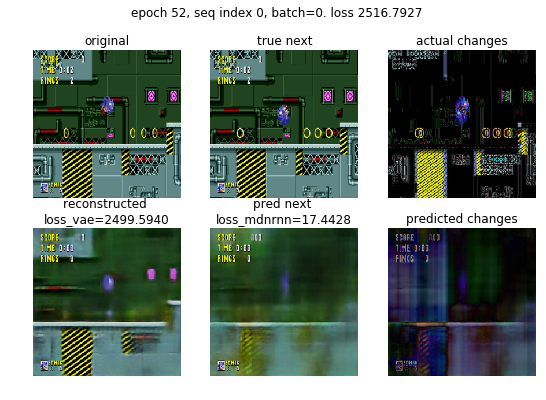

action_pred 2
action_true 2.0
finv loss 0.7119


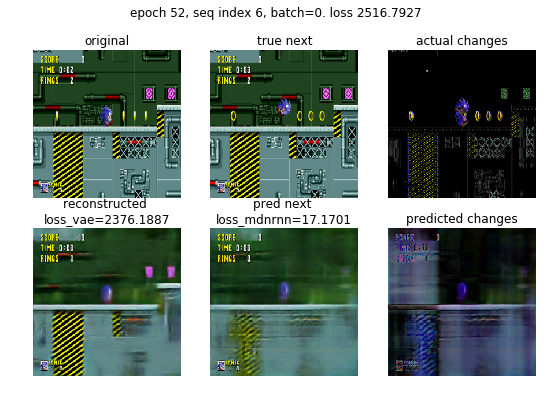

[0/1250] loss=45.7301, loss_rnn=17.0172, loss_inv= 0.7123=1* 0.7123, loss_vae=28.0006=0.0083 * (3359.34 + 0.15*|4.89 - 0|)
[400/1250] loss=51.7783, loss_rnn=17.0875, loss_inv= 0.7160=1* 0.7160, loss_vae=22.6171=0.0083 * (2713.21 + 0.15*|5.65 - 0|)
[800/1250] loss=23.5644, loss_rnn=17.0782, loss_inv= 0.7159=1* 0.7159, loss_vae=23.3760=0.0083 * (2804.26 + 0.15*|5.73 - 0|)
[1200/1250] loss=42.3176, loss_rnn=17.1146, loss_inv= 0.7159=1* 0.7159, loss_vae=25.4652=0.0083 * (3054.95 + 0.15*|5.81 - 0|)
loss=39.3585, loss_rnn=17.1248, loss_inv= 0.7158=1* 0.7158, loss_vae=25.4313=0.0083 * (3050.88 + 0.15*|5.82 - 0|)



[0/208] loss=53.6600, loss_rnn=17.3189, loss_inv= 0.7123=1* 0.7123, loss_vae=35.6288=0.0083 * (4274.55 + 0.15*|6.05 - 0|)
loss=40.8441, loss_rnn=17.2585, loss_inv= 0.7163=1* 0.7163, loss_vae=27.0744=0.0083 * (3248.04 + 0.15*|5.94 - 0|)

Epoch 53, loss=17.1248, loss_val=17.2585, loss_vae=3051.7561, loss_vae_val=3248.9302,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 0.0
finv loss 0.7258


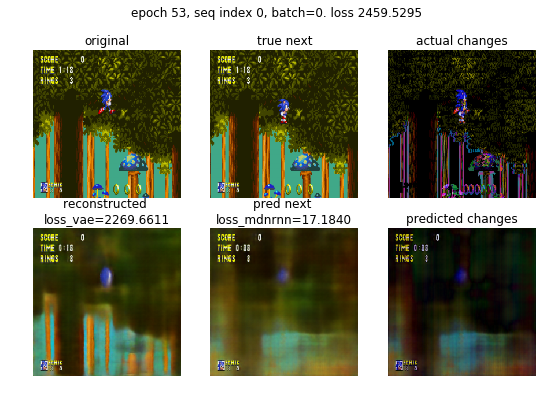

action_pred 2
action_true 7.0
finv loss 0.7258


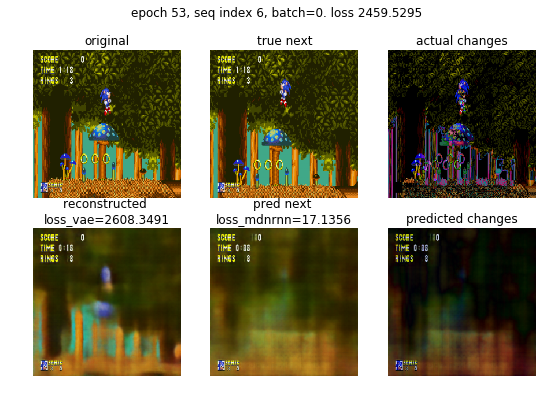

[0/1250] loss=16.3200, loss_rnn=14.7903, loss_inv= 0.6981=1* 0.6981, loss_vae=0.8317=0.0083 * (99.15 + 0.15*|4.35 - 0|)
[400/1250] loss=60.0219, loss_rnn=16.9167, loss_inv= 0.7159=1* 0.7159, loss_vae=19.9143=0.0083 * (2388.86 + 0.15*|5.72 - 0|)
[800/1250] loss=66.8602, loss_rnn=17.0376, loss_inv= 0.7156=1* 0.7156, loss_vae=20.9569=0.0083 * (2513.95 + 0.15*|5.89 - 0|)
[1200/1250] loss=31.9291, loss_rnn=17.0041, loss_inv= 0.7158=1* 0.7158, loss_vae=22.4125=0.0083 * (2688.62 + 0.15*|5.84 - 0|)
loss=42.8758, loss_rnn=17.0134, loss_inv= 0.7159=1* 0.7159, loss_vae=22.2281=0.0083 * (2666.49 + 0.15*|5.84 - 0|)



[0/208] loss=31.9100, loss_rnn=17.2189, loss_inv= 0.7266=1* 0.7266, loss_vae=13.9645=0.0083 * (1674.84 + 0.15*|6.01 - 0|)
loss=49.2771, loss_rnn=17.1315, loss_inv= 0.7156=1* 0.7156, loss_vae=22.7920=0.0083 * (2734.24 + 0.15*|5.37 - 0|)

Epoch 54, loss=17.0134, loss_val=17.1315, loss_vae=2667.3696, loss_vae_val=2735.0415,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  2,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 6.0
finv loss 0.7143


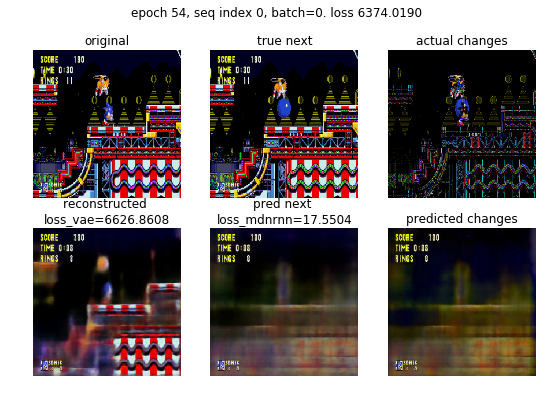

action_pred 2
action_true 9.0
finv loss 0.7143


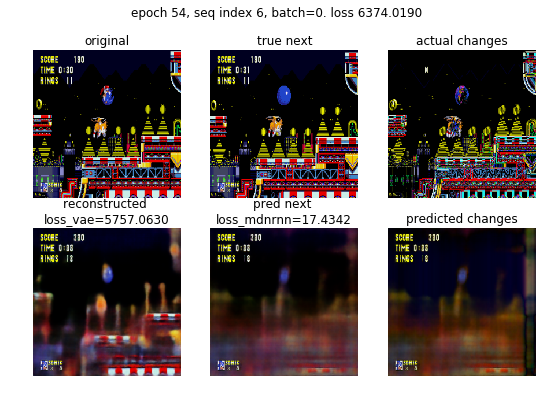

[0/1250] loss=45.3370, loss_rnn=17.4269, loss_inv= 0.6852=1* 0.6852, loss_vae=27.2249=0.0083 * (3266.22 + 0.15*|5.08 - 0|)
[400/1250] loss=19.9371, loss_rnn=17.1566, loss_inv= 0.7161=1* 0.7161, loss_vae=18.9034=0.0083 * (2267.60 + 0.15*|5.41 - 0|)
[800/1250] loss=53.8886, loss_rnn=16.9794, loss_inv= 0.7169=1* 0.7169, loss_vae=19.0990=0.0083 * (2291.08 + 0.15*|5.32 - 0|)
[1200/1250] loss=35.3809, loss_rnn=16.9952, loss_inv= 0.7164=1* 0.7164, loss_vae=20.6111=0.0083 * (2472.53 + 0.15*|5.34 - 0|)
loss=34.2074, loss_rnn=17.0018, loss_inv= 0.7164=1* 0.7164, loss_vae=20.4178=0.0083 * (2449.33 + 0.15*|5.35 - 0|)



[0/208] loss=42.8876, loss_rnn=17.0333, loss_inv= 0.7266=1* 0.7266, loss_vae=25.1277=0.0083 * (3014.73 + 0.15*|3.98 - 0|)
loss=37.6334, loss_rnn=17.1622, loss_inv= 0.7160=1* 0.7160, loss_vae=21.7882=0.0083 * (2613.86 + 0.15*|4.86 - 0|)

Epoch 55, loss=17.0018, loss_val=17.1622, loss_vae=2450.1333, loss_vae_val=2614.5886,  loss_finv=nan, loss_finv_vae=nan, ,
tensor([[ 2,  2,  2,  8,  2,  2,  2]], device='cuda:0')
action_pred 2
action_true 8.0
finv loss 0.7253


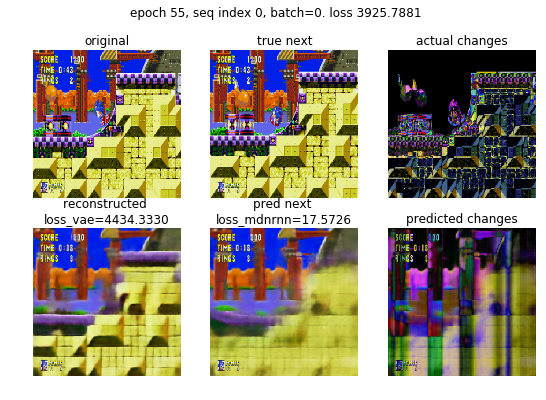

action_pred 2
action_true 6.0
finv loss 0.7253


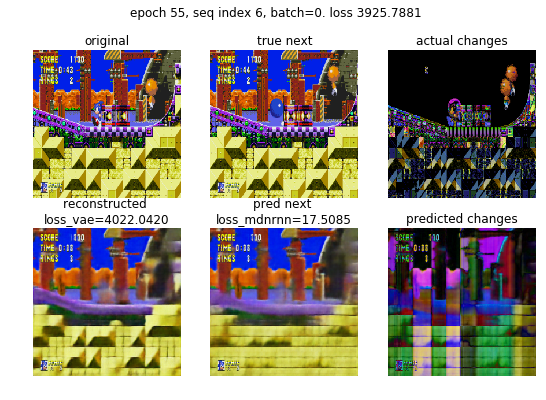

[0/1250] loss=43.2865, loss_rnn=17.0871, loss_inv= 0.7266=1* 0.7266, loss_vae=25.4728=0.0083 * (3056.04 + 0.15*|4.67 - 0|)
[400/1250] loss=38.8389, loss_rnn=16.9466, loss_inv= 0.7163=1* 0.7163, loss_vae=19.8557=0.0083 * (2381.89 + 0.15*|5.28 - 0|)
[800/1250] loss=46.1992, loss_rnn=16.9309, loss_inv= 0.7172=1* 0.7172, loss_vae=21.1144=0.0083 * (2532.89 + 0.15*|5.61 - 0|)


In [ ]:
for epoch in range(num_epochs):
    # Run
    info = train(loader_train, vae, mdnrnn, optimizer, max_batches=max_batches, test=False, cuda=True, joint_training=True)
    torch.cuda.empty_cache()
    info_val = train(loader_test, vae, mdnrnn, optimizer, max_batches=max_batches//6, test=True, cuda=True, joint_training=True)
    torch.cuda.empty_cache()
    
    # Adjust
    scheduler.step(np.mean(info_val['loss_mdn']))
    
    # View
    print('Epoch {}, loss={:2.4f}, loss_val={:2.4f}, loss_vae={:2.4f}, loss_vae_val={:2.4f},  loss_finv={:2.4f}, loss_finv_vae={:2.4f}, ,'.format(
        epoch, 
        np.mean(info['loss_mdn']), 
        np.mean(info_val['loss_mdn']),
        np.mean(info['loss_vae']), 
        np.mean(info_val['loss_vae']),
        np.mean(info['loss_finv']),
        np.mean(info_val['loss_finv'])
    ))
    plot_results(loader_test, n=2, epoch=epoch)
    
    # Record
    history = {k+'_val':np.mean(v) for k,v in info_val.items()}
    history.update({k:np.mean(v) for k,v in info.items()})
    histories.append(history)
    
    torch.save(mdnrnn.state_dict(), './outputs/{NAME}/checkpoint_{epoch}_mdnrnn_state_dict.pkl'.format(NAME=NAME, epoch=epoch))
    torch.save(vae.state_dict(), './outputs/{NAME}/checkpoint_{epoch}_vae_state_dict.pkl'.format(NAME=NAME, epoch=epoch))
    torch.save(finv.state_dict(), './outputs/{NAME}/checkpoint_{epoch}_finv_state_dict.pkl'.format(NAME=NAME, epoch=epoch))
    
    # Tidy
    torch.cuda.empty_cache()

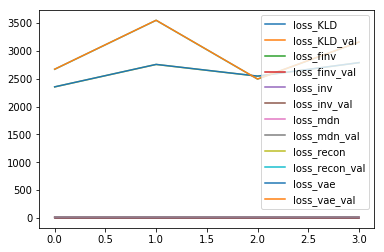

In [29]:
import pandas as pd
df_history = pd.DataFrame(histories)
df_history.plot()

df_history.to_csv(history_file, index=False)


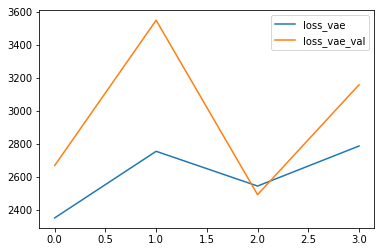

In [30]:
df_history[['loss_vae','loss_vae_val']].plot()

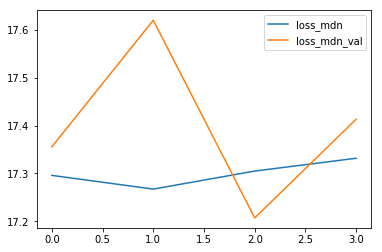

In [31]:
df_history[['loss_mdn','loss_mdn_val']].plot()

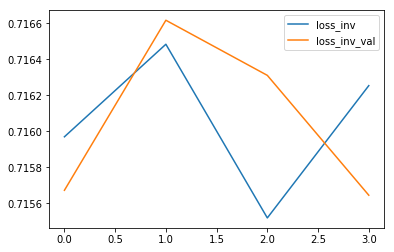

In [32]:
df_history[['loss_inv','loss_inv_val']].plot()

## Save

In [33]:
torch.save(mdnrnn.state_dict(), './outputs/{NAME}/mdnrnn_state_dict.pkl'.format(NAME=NAME))
torch.save(vae.state_dict(), './outputs/{NAME}/vae_state_dict.pkl'.format(NAME=NAME))
torch.save(finv.state_dict(), './outputs/{NAME}/finv_state_dict.pkl'.format(NAME=NAME))
# torch.save(mdnrnn, f'./outputs/models/{NAME}-mdnrnn.pkl')
# torch.save(vae, f'./outputs/models/{NAME}-vae')
# torch.save(finv.state_dict(), f'./outputs/models/{NAME}-finv.pkl')

## View

In [ ]:
plot_results(loader_test, n=4, epoch=0)

In [ ]:
plot_results(loader_train, n=4, epoch=0)

In [ ]:
torch.cuda.empty_cache()

# Summarize models

In [37]:
from IPython.display import display
with torch.no_grad():
    img = np.random.randn(image_size, image_size, 3)
    action = np.array(np.random.randint(0,action_dim))[np.newaxis]
    action = Variable(torch.from_numpy(action)).float().cuda()[np.newaxis]
    gpu_img = Variable(torch.from_numpy(img[np.newaxis].transpose(0, 3, 1, 2))).float().cuda()
    if cuda:
        gpu_img = gpu_img.cuda()
    with TorchSummarizeDf(vae) as tdf:
        x, mu_vae, logvar_vae = vae.forward(gpu_img)
        z = vae.sample(mu_vae, logvar_vae)
        df_vae = tdf.make_df()

    display(df_vae[df_vae.level<2])
    
    with TorchSummarizeDf(mdnrnn) as tdf: 
        pi, mu, sigma, hidden_state = mdnrnn.forward(z.unsqueeze(1).repeat((1,2,1)), action.repeat((1,2)))
        z_next = mdnrnn.sample(pi, mu, sigma)
        df_mdnrnn = tdf.make_df()
    
    display(df_mdnrnn)
    

    with TorchSummarizeDf(finv) as tdf:
        finv(z.repeat((1,2,1)), z_next)   
        df_finv = tdf.make_df()
    display(df_finv)

#     with TorchSummarizeDf(world_model) as tdf:
#         world_model(gpu_img, action)
#         df_world_model = tdf.make_df()
#     display(df_world_model[df_world_model.level<2])
    
    del img, action, gpu_img, x, mu, z, z_next, mu_vae, logvar_vae, pi, sigma

Total parameters 21877123
Total trainable parameters 21877123


,name,class_name,input_shape,output_shape,nb_params,level
4,encoder.0,ConvBlock4,"[(-1, 3, 256, 256)]","[(-1, 64, 256, 256)]",1920,1
8,encoder.1,ConvBlock4,"[(-1, 64, 256, 256)]","[(-1, 128, 128, 128)]",131456,1
12,encoder.2,ConvBlock4,"[(-1, 128, 128, 128)]","[(-1, 192, 64, 64)]",393792,1
16,encoder.3,ConvBlock4,"[(-1, 192, 64, 64)]","[(-1, 256, 32, 32)]",787200,1
20,encoder.4,ConvBlock4,"[(-1, 256, 32, 32)]","[(-1, 320, 16, 16)]",1311680,1
24,encoder.5,ConvBlock4,"[(-1, 320, 16, 16)]","[(-1, 384, 8, 8)]",1967232,1
25,encoder.6,Conv2d,"[(-1, 384, 8, 8)]","[(-1, 128, 8, 8)]",49280,1
26,mu,Linear,"[(-1, 8192)]","[(-1, 512)]",4194816,0
27,logvar,Linear,"[(-1, 8192)]","[(-1, 512)]",4194816,0
28,z,Linear,"[(-1, 512)]","[(-1, 8192)]",4202496,0


Total parameters 11565056
Total trainable parameters 11565056


,name,class_name,input_shape,output_shape,nb_params,level
1,rnn,LSTM,"[[(-1, 2, 522)], [[(-1, 1, 512)], [(-1, 1, 512...","[[(-1, 2, 512)], [[(-1, 1, 512)], [(-1, 1, 512...",2121728,0
2,ln1,Linear,"[(-1, 512), (-1, 512)]","[(-1, 512), (-1, 512)]",262656,0
3,ln2,Linear,"[(-1, 512), (-1, 512)]","[(-1, 2560), (-1, 2560)]",1313280,0
4,mdn,Linear,"[(-1, 2560), (-1, 2560)]","[(-1, 3072), (-1, 3072)]",7867392,0


Total parameters 330762
Total trainable parameters 330762


,name,class_name,input_shape,output_shape,nb_params,level
1,ln1,Linear,"[(-1, 2, 1024)]","[(-1, 2, 256)]",262400,0
2,ln2,Linear,"[(-1, 2, 256)]","[(-1, 2, 256)]",65792,0
3,ln3,Linear,"[(-1, 2, 256)]","[(-1, 2, 10)]",2570,0


# DEBUG

In [ ]:
# DEBUG the distributions
vae.train()
mdnrnn.train()

observations, actions, rewards, dones = next(iter(loader_train))

X = Variable(observations.transpose(1,3))
_, channels, height, width = X.size()
if cuda:
    X=X.cuda()
Y, mu_vae, logvar = vae.forward(X)
loss_recon, loss_KLD = loss_function_vae(Y, X, mu_vae, logvar)
loss_vae = loss_recon + lambda_vae_kld * torch.abs(loss_KLD-C)

# TODO do we want to sample in test or training mode?
z_v = vae.sample(mu_vae, logvar)

z_v = z_v.view(batch_size, seq_len, -1)
Y = Y.view((batch_size, seq_len, channels, height, width))
X = X.view((batch_size, seq_len, channels, height, width))
loss_vae = loss_vae.view(batch_size, seq_len, -1)
actions = actions.view(batch_size, seq_len)

# Forward
actions_v = Variable(actions).float()


if cuda:
    z_v=z_v.cuda()
    actions_v=actions_v.cuda()
pi, mu, sigma, hidden_state = mdnrnn.forward(z_v, actions_v)

loss = mdnrnn.rnn_loss(z_v, pi, mu, sigma)

# mu = mu.mean(2).view((batch_size*seq_len, mdnrnn.z_dim))
# X_pred = vae.decode(mu)
# X_pred = X_pred.view((batch_size, seq_len, channels, height, width))


mdnrnn.train()

zs=mdnrnn.sample(pi, mu, sigma)







z_v = vae.sample(mu_vae, logvar)
plt.hist(z_v.cpu().data.numpy().flatten(), bins=50)
plt.title('z_v')
plt.show()

plt.hist(zs.cpu().data.numpy().flatten(), bins=50)
plt.title('z_pred')
plt.show()

plt.hist(mu_vae.cpu().data.numpy().flatten(), bins=50)
plt.title('mu_vae')
plt.show()

plt.hist(mu.cpu().data.numpy().flatten(), bins=50)
plt.title('mu')
plt.show()

plt.hist(logvar.exp().cpu().data.numpy().flatten(), bins=50)
plt.title('sigma_vae')
plt.show()

plt.hist(sigma.cpu().data.numpy().flatten(), bins=50)
plt.title('sigma')
plt.show()
